In [ ]:
!pip install torch torchvision timm transformers



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 83.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 66.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 47.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 99.3 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
import os
import numpy as np
import torch
import torchvision.transforms as T
from PIL import Image
from torchvision.transforms.functional import InterpolationMode
from transformers import AutoModel, AutoTokenizer

IMAGENET_MEAN = (0.485, 0.456, 0.406)
IMAGENET_STD = (0.229, 0.224, 0.225)

def build_transform(input_size):
    MEAN, STD = IMAGENET_MEAN, IMAGENET_STD
    transform = T.Compose([
        T.Lambda(lambda img: img.convert('RGB') if img.mode != 'RGB' else img),
        T.Resize((input_size, input_size), interpolation=InterpolationMode.BICUBIC),
        T.ToTensor(),
        T.Normalize(mean=MEAN, std=STD)
    ])
    return transform

def find_closest_aspect_ratio(aspect_ratio, target_ratios, width, height, image_size):
    best_ratio_diff = float('inf')
    best_ratio = (1, 1)
    area = width * height
    for ratio in target_ratios:
        target_aspect_ratio = ratio[0] / ratio[1]
        ratio_diff = abs(aspect_ratio - target_aspect_ratio)
        if ratio_diff < best_ratio_diff:
            best_ratio_diff = ratio_diff
            best_ratio = ratio
        elif ratio_diff == best_ratio_diff:
            if area > 0.5 * image_size * image_size * ratio[0] * ratio[1]:
                best_ratio = ratio
    return best_ratio

def dynamic_preprocess(image, min_num=1, max_num=12, image_size=448, use_thumbnail=False):
    orig_width, orig_height = image.size
    aspect_ratio = orig_width / orig_height

    # calculate the existing image aspect ratio
    target_ratios = set(
        (i, j) for n in range(min_num, max_num + 1) for i in range(1, n + 1) for j in range(1, n + 1) if
        i * j <= max_num and i * j >= min_num)
    target_ratios = sorted(target_ratios, key=lambda x: x[0] * x[1])

    # find the closest aspect ratio to the target
    target_aspect_ratio = find_closest_aspect_ratio(
        aspect_ratio, target_ratios, orig_width, orig_height, image_size)

    # calculate the target width and height
    target_width = image_size * target_aspect_ratio[0]
    target_height = image_size * target_aspect_ratio[1]
    blocks = target_aspect_ratio[0] * target_aspect_ratio[1]

    # resize the image
    resized_img = image.resize((target_width, target_height))
    processed_images = []
    for i in range(blocks):
        box = (
            (i % (target_width // image_size)) * image_size,
            (i // (target_width // image_size)) * image_size,
            ((i % (target_width // image_size)) + 1) * image_size,
            ((i // (target_width // image_size)) + 1) * image_size
        )
        # split the image
        split_img = resized_img.crop(box)
        processed_images.append(split_img)
    assert len(processed_images) == blocks
    if use_thumbnail and len(processed_images) != 1:
        thumbnail_img = image.resize((image_size, image_size))
        processed_images.append(thumbnail_img)
    return processed_images

def load_image(image_file, input_size=448, max_num=12):
    image = Image.open(image_file).convert('RGB')
    transform = build_transform(input_size=input_size)
    images = dynamic_preprocess(image, image_size=input_size, use_thumbnail=True, max_num=max_num)
    pixel_values = [transform(image) for image in images]
    pixel_values = torch.stack(pixel_values)
    return pixel_values


In [ ]:
model_name = "5CD-AI/Vintern-1B-v2"
model_name = "5CD-AI/Vintern-1B-v3_5"

try:
  model = AutoModel.from_pretrained(
      model_name,
      torch_dtype=torch.bfloat16,
      low_cpu_mem_usage=True,
      trust_remote_code=True,
      use_flash_attn=False,
  ).eval().cuda()
except:
  model = AutoModel.from_pretrained(
      model_name,
      torch_dtype=torch.bfloat16,
      low_cpu_mem_usage=True,
      trust_remote_code=True
  ).eval().cuda()

tokenizer = AutoTokenizer.from_pretrained(model_name, trust_remote_code=True, use_fast=False)


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/5.30k [00:00<?, ?B/s]

configuration_internvl_chat.py:   0%|          | 0.00/3.88k [00:00<?, ?B/s]

configuration_intern_vit.py:   0%|          | 0.00/5.55k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/5CD-AI/Vintern-1B-v3_5:
- configuration_intern_vit.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
A new version of the following files was downloaded from https://huggingface.co/5CD-AI/Vintern-1B-v3_5:
- configuration_internvl_chat.py
- configuration_intern_vit.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_internvl_chat.py:   0%|          | 0.00/15.6k [00:00<?, ?B/s]

conversation.py:   0%|          | 0.00/16.4k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/5CD-AI/Vintern-1B-v3_5:
- conversation.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


modeling_intern_vit.py:   0%|          | 0.00/18.1k [00:00<?, ?B/s]

A new version of the following files was downloaded from https://huggingface.co/5CD-AI/Vintern-1B-v3_5:
- modeling_intern_vit.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.
A new version of the following files was downloaded from https://huggingface.co/5CD-AI/Vintern-1B-v3_5:
- modeling_internvl_chat.py
- conversation.py
- modeling_intern_vit.py
. Make sure to double-check they do not contain any added malicious code. To avoid downloading new versions of the code file, you can pin a revision.


FlashAttention2 is not installed.


/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


model.safetensors:   0%|          | 0.00/3.75G [00:00<?, ?B/s]

Sliding Window Attention is enabled but not implemented for `eager`; unexpected results may be encountered.


generation_config.json:   0%|          | 0.00/129 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/9.02k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/3.38M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/1.67M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/790 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/744 [00:00<?, ?B/s]

In [ ]:
'''
Google Colab Notebook: Chuyển PDF (chỉ trang đầu) từ thư mục Drive này sang ảnh PNG và upload vào thư mục khác, dùng folder IDs.

- SOURCE_FOLDER_ID: folder ID chứa PDF
- DEST_FOLDER_ID: folder ID lưu ảnh
'''
!pip install pdf2image
# 1. Authenticate & Build Drive API Client
from google.colab import auth
auth.authenticate_user()
from googleapiclient.discovery import build
from googleapiclient.http import MediaIoBaseDownload, MediaFileUpload
import io
import os

drive_service = build('drive', 'v3')

from pdf2image import convert_from_bytes

# 3. Thiết lập folder IDs
SOURCE_FOLDER_ID = '1z8-ag2hyXhetyo67PISO5TB6yOlJw7FB'
DEST_FOLDER_ID   = '12RlDiAswFlve6keAuOCcY979KNuG-Oou'

# 4. Lấy danh sách PDF trong thư mục nguồn
query = f"'{SOURCE_FOLDER_ID}' in parents and mimeType='application/pdf' and trashed=false"
response = drive_service.files().list(q=query, fields='files(id,name)').execute()
files = response.get('files', [])

if not files:
    print('Không tìm thấy file PDF nào trong thư mục nguồn.')
else:
    for f in files:
        file_id = f['id']
        name    = f['name']
        print(f"\nĐang xử lý: {name} (ID: {file_id})")

        # Download PDF
        request = drive_service.files().get_media(fileId=file_id)
        fh = io.BytesIO()
        downloader = MediaIoBaseDownload(fh, request)
        done = False
        while not done:
            status, done = downloader.next_chunk()
        pdf_bytes = fh.getvalue()

        # Convert trang đầu thành ảnh
        try:
            images = convert_from_bytes(pdf_bytes, first_page=1, last_page=1)
        except Exception as e:
            print(f"Lỗi chuyển PDF: {e}")
            continue

        img = images[0]
        base = os.path.splitext(name)[0]
        img_name = base + '.png'
        img.save(img_name, 'PNG')
        print(f"→ Đã lưu tạm ảnh: {img_name}")

        # Upload lên thư mục đích
        media = MediaFileUpload(img_name, mimetype='image/png')
        file_metadata = {'name': img_name, 'parents': [DEST_FOLDER_ID]}
        uploaded = drive_service.files().create(body=file_metadata, media_body=media, fields='id').execute()
        print(f"→ Upload thành công: {img_name} (ID: {uploaded['id']})")

        # Xóa file tạm
        os.remove(img_name)

print('\nHoàn thành xử lý tất cả file!')



Đang xử lý: 2C25TKT_00000018.pdf (ID: 1ekeb0n3zI9cD4cQApND38lPgNfBU7dZF)
Lỗi chuyển PDF: Unable to get page count. Is poppler installed and in PATH?

Đang xử lý: 2C25TKT_00000017.pdf (ID: 1aQoYxdzMN4EQoUBwPQ4EWdOGF4ppJzzU)
Lỗi chuyển PDF: Unable to get page count. Is poppler installed and in PATH?

Đang xử lý: 2C25TKT_00000016.pdf (ID: 1Kv6MCwwQnPo3zYIgP90TE3QBhpcQu64Y)
Lỗi chuyển PDF: Unable to get page count. Is poppler installed and in PATH?

Đang xử lý: 2C25TKT_00000015.pdf (ID: 1EUiuPOsi3z3gHPWEIUXBP0JUb7mi7g6m)
Lỗi chuyển PDF: Unable to get page count. Is poppler installed and in PATH?

Đang xử lý: 2C25TKT_00000014.pdf (ID: 1dozJLRYAgeHOWNcrdEFi_dFAD71WknMm)
Lỗi chuyển PDF: Unable to get page count. Is poppler installed and in PATH?

Đang xử lý: 2C25TKT_00000013.pdf (ID: 1KmMUmlfgS0_JGQmbRGSryJJK4NvQC1sU)
Lỗi chuyển PDF: Unable to get page count. Is poppler installed and in PATH?

Đang xử lý: 2C25TKT_00000012.pdf (ID: 1QmuKy7zalc23TdhOF63VWAGQmXlK--Jc)
Lỗi chuyển PDF: Unable to 

Mounted at /content/drive
Đang xử lý: 2C25TKT_00000001.png


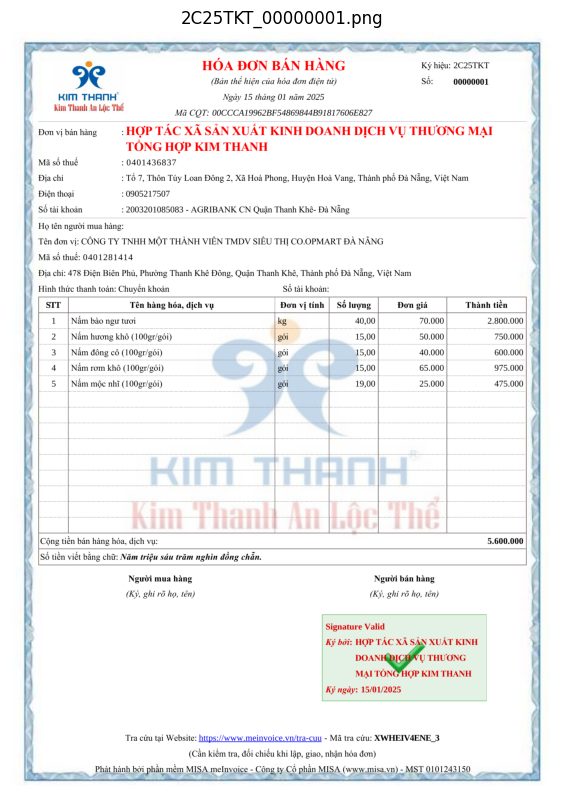

Token indices sequence length is longer than the specified maximum sequence length for this model (1982 > 1700). Running this sequence through the model will result in indexing errors
Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000001.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "15/01/2025",
    "Tên khách hàng": "CÔNG TY TNHH MỘT THÀNH VIÊN TMDV SIÊU THỊ CO.OPMART ĐÀ NẴNG"
  },
  {
    "Tên mặt hàng": "Nấm bào ngư tươi",
    "Đơn vị tính": "kg",
    "Số lượng": "40,00",
    "Đơn giá": "70,000",
    "Thành tiền": "2,800,000"
  },
  {
    "Tên mặt hàng": "Nấm hương khô (100gr/gói)",
    "Đơn vị tính": "gói",
    "Số lượng": "15,00",
    "Đơn giá": "50,000",
    "Thành tiền": "750,000"
  },
  {
    "Tên mặt hàng": "Nấm đông cô (100gr/gói)",
    "Đơn vị tính": "gói",
    "Số lượng": "15,00",
   

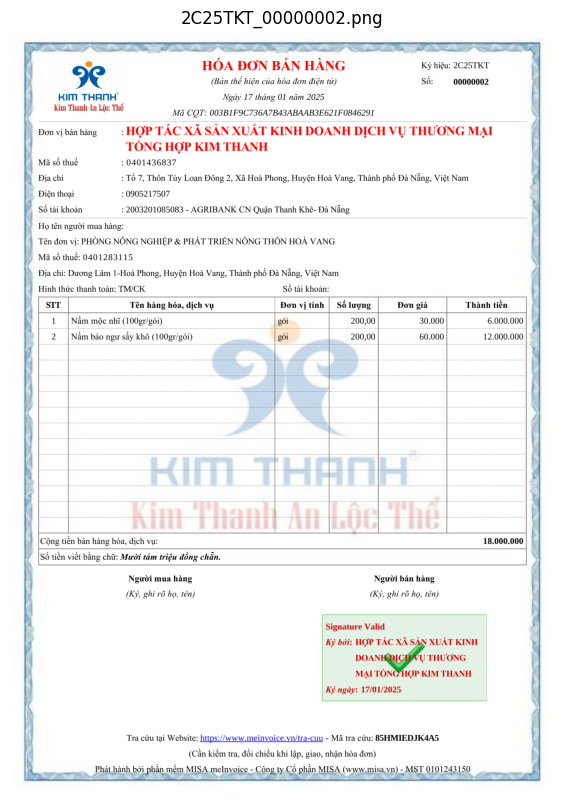

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000002.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "17/01/2025",
    "Tên khách hàng": "PHÒNG NÔNG NGHIỆP & PHÁT TRIỂN NÔNG THÔN HOÀ VANG"
  },
  {
    "Tên mặt hàng": "Nấm mộc nhỉ (100gr/gói)",
    "Đơn vị tính": "gói",
    "Số lượng": "200,00",
    "Đơn giá": "30.000",
    "Thành tiền": "6.000.000"
  },
  {
    "Tên mặt hàng": "Nấm bào ngư sấy khô (100gr/gói)",
    "Đơn vị tính": "gói",
    "Số lượng": "200,00",
    "Đơn giá": "60.000",
    "Thành tiền": "12.000.000"
  }
]

Đang xử lý: 2C25TKT_00000003.png


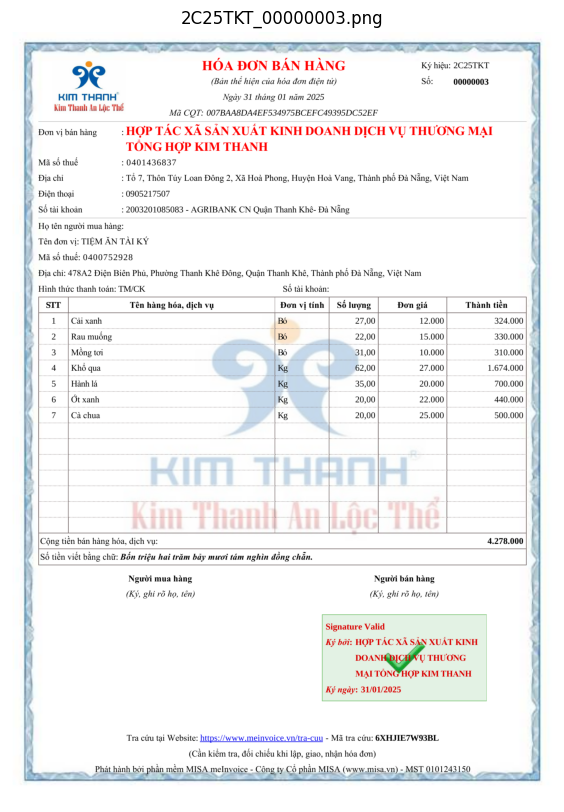

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000003.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "31/01/2025",
    "Tên khách hàng": "TIỆM ĂN TÀI KÝ"
  },
  {
    "Tên mặt hàng": "Cải xanh",
    "Đơn vị tính": "Bó",
    "Số lượng": "27,00",
    "Đơn giá": "12,000",
    "Thành tiền": "324,000"
  },
  {
    "Tên mặt hàng": "Rau muống",
    "Đơn vị tính": "Bó",
    "Số lượng": "22,00",
    "Đơn giá": "15,000",
    "Thành tiền": "330,000"
  },
  {
    "Tên mặt hàng": "Mồng tơi",
    "Đơn vị tính": "Bó",
    "Số lượng": "31,00",
    "Đơn giá": "10,000",
    "Thành tiền": "310,000"
  },
  {
    "Tên mặt hàng": "Khổ qua"

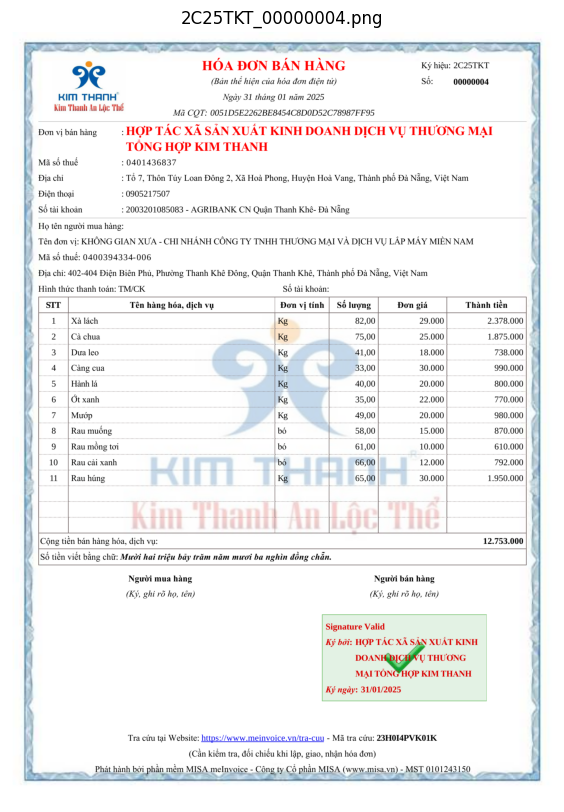

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000004.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "31/01/2025",
    "Tên khách hàng": "KHÔNG GIAN XƯA - CHI NHÁNH CÔNG TY TNHH THƯƠNG MẠI VÀ DỊCH VỤ LẮP MÁY MIỀN NAM"
  },
  {
    "Tên mặt hàng": "Xà lách",
    "Đơn vị tính": "kg",
    "Số lượng": "82,00",
    "Đơn giá": "29,000",
    "Thành tiền": "2.378.000"
  },
  {
    "Tên mặt hàng": "Cà chua",
    "Đơn vị tính": "kg",
    "Số lượng": "75,00",
    "Đơn giá": "25,000",
    "Thành tiền": "1.875.000"
  },
  {
    "Tên mặt hàng": "Dưa leo",
    "Đơn vị tính": "kg",
    "Số lượng": "41,00",
    "Đơn giá": "18,000",
  

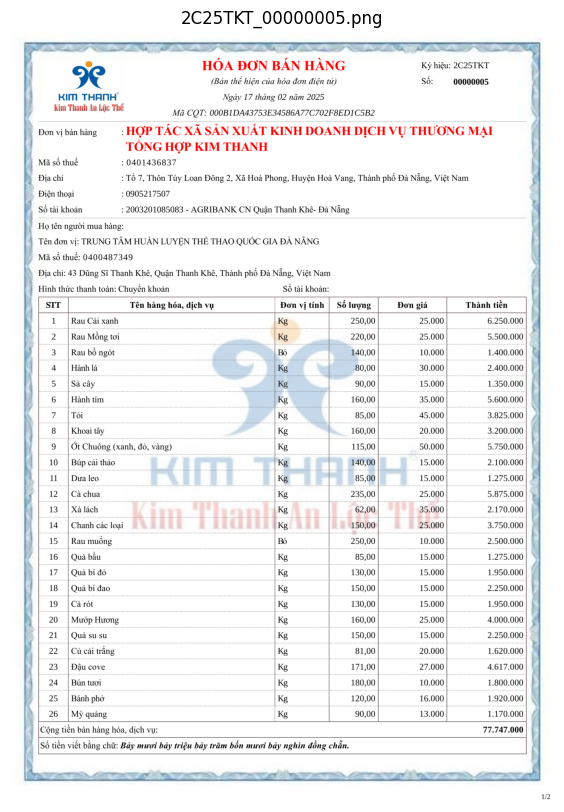

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000005.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "17 tháng 02 năm 2025",
    "Tên khách hàng": "TRUNG TÂM HUẤN LUYỆN THỂ THAO QUỐC GIA ĐÀ NẴNG"
  },
  {
    "Tên mặt hàng": "Rau Cải xanh",
    "Đơn vị tính": "kg",
    "Số lượng": "250,00",
    "Đơn giá": "25,000",
    "Thành tiền": "6.250.000"
  },
  {
    "Tên mặt hàng": "Rau Mồng tơi",
    "Đơn vị tính": "kg",
    "Số lượng": "220,00",
    "Đơn giá": "25,000",
    "Thành tiền": "5.500.000"
  },
  {
    "Tên mặt hàng": "Rau bồ ngót",
    "Đơn vị tính": "kg",
    "Số lượng": "140,00",
    "Đơn giá": "10,000",
    "Th

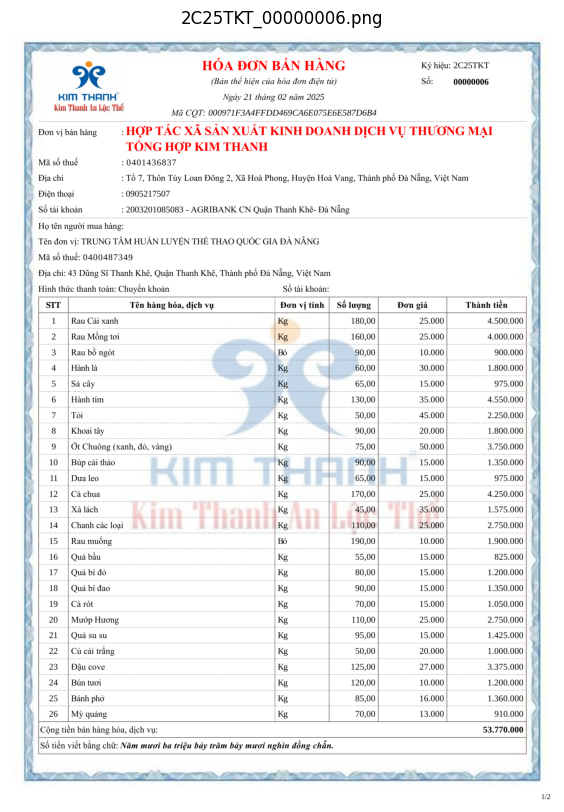

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000006.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "21 tháng 02 năm 2025",
    "Tên khách hàng": "TRUNG TÂM HUẤN LUYỆN THỂ THAO QUỐC GIA ĐÀ NẴNG"
  },
  {
    "Tên mặt hàng": "Rau Cải xanh",
    "Đơn vị tính": "kg",
    "Số lượng": "180,00",
    "Đơn giá": "25,000",
    "Thành tiền": "4.500.000"
  },
  {
    "Tên mặt hàng": "Rau Mồng tơi",
    "Đơn vị tính": "kg",
    "Số lượng": "160,00",
    "Đơn giá": "25,000",
    "Thành tiền": "4.000.000"
  },
  {
    "Tên mặt hàng": "Rau bồ ngót",
    "Đơn vị tính": "kg",
    "Số lượng": "90,00",
    "Đơn giá": "10,000",
    "Thà

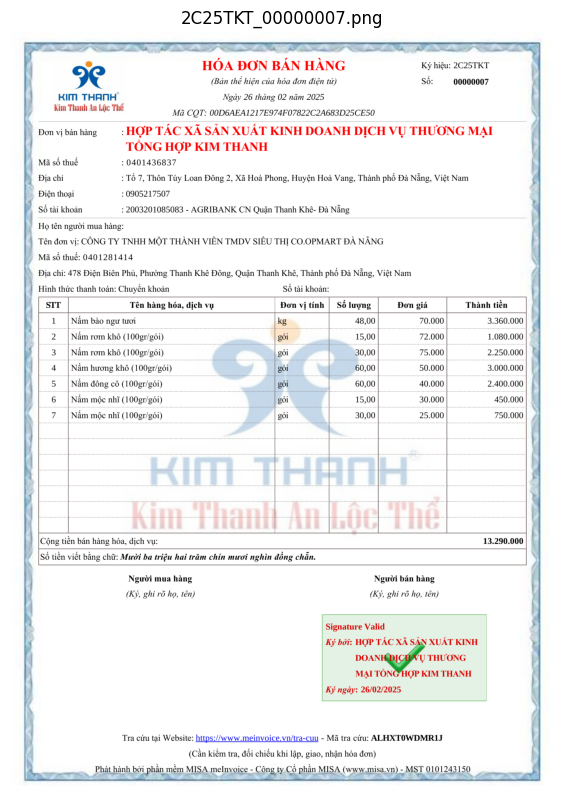

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000007.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "26/02/2025",
    "Tên khách hàng": "CÔNG TY TNHH MỘT THÀNH VIÊN TMDV SIÊU THỊ CO.OPMART ĐÀ NẴNG"
  },
  {
    "Tên mặt hàng": "Nấm bào ngư tươi",
    "Đơn vị tính": "kg",
    "Số lượng": "48,00",
    "Đơn giá": "70,000",
    "Thành tiền": "3,360,000"
  },
  {
    "Tên mặt hàng": "Nấm rơm khô (100gr/gói)",
    "Đơn vị tính": "gói",
    "Số lượng": "15,00",
    "Đơn giá": "72,000",
    "Thành tiền": "1,080,000"
  },
  {
    "Tên mặt hàng": "Nấm rơm khô (100gr/gói)",
    "Đơn vị tính": "gói",
    "Số lượng": "30,00",
   

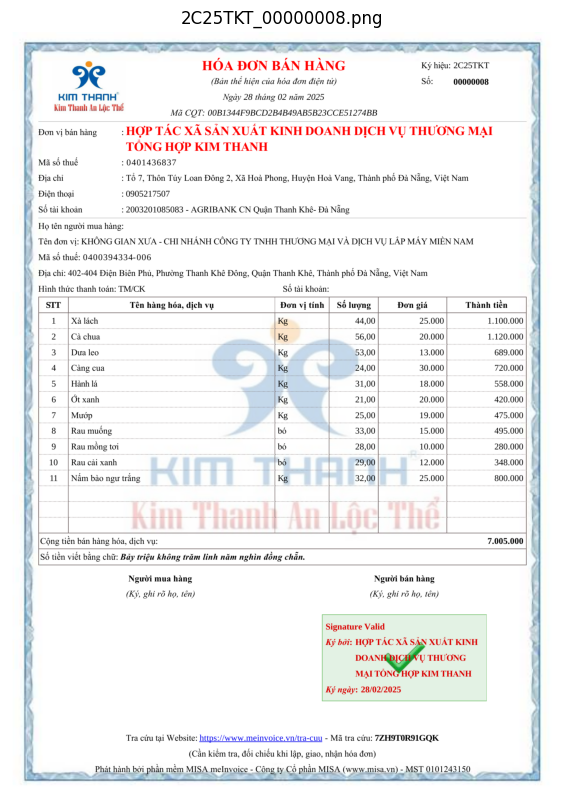

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000008.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "28/02/2025",
  "Tên khách hàng": "KHÔNG GIAN XƯA - CHI NHÁNH CÔNG TY TNHH THƯƠNG MẠI VÀ DỊCH VỤ LẮP MÁY MIỀN NAM",
  "Tên mặt hàng": "Xà lách",
  "Đơn vị tính": "kg",
  "Số lượng": "44,00",
  "Đơn giá": "25,000",
  "Thành tiền": "1.100.000"
},
{
  "Ngày tạo đơn": "28/02/2025",
  "Tên khách hàng": "KHÔNG GIAN XƯA - CHI NHÁNH CÔNG TY TNHH THƯƠNG MẠI VÀ DỊCH VỤ LẮP MÁY MIỀN NAM",
  "Tên mặt hàng": "Cà chua",
  "Đơn vị tính": "kg",
  "Số lượng": "56,00",
  "Đơn giá": "20,000",
  "Thành tiền": "1.120.000"
},
{
  "Ngày tạo đơn": 

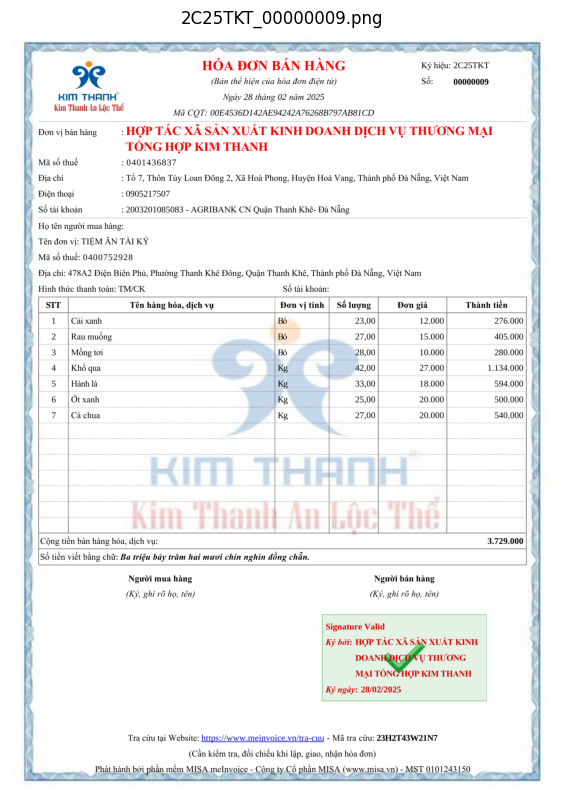

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000009.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "28/02/2025",
    "Tên khách hàng": "TIỆM ĂN TÀI KÝ"
  },
  {
    "Tên mặt hàng": "Cải xanh",
    "Đơn vị tính": "Bó",
    "Số lượng": "23,00",
    "Đơn giá": "12,000",
    "Thành tiền": "276,000"
  },
  {
    "Tên mặt hàng": "Rau muống",
    "Đơn vị tính": "Bó",
    "Số lượng": "27,00",
    "Đơn giá": "15,000",
    "Thành tiền": "405,000"
  },
  {
    "Tên mặt hàng": "Mồng tơi",
    "Đơn vị tính": "Bó",
    "Số lượng": "28,00",
    "Đơn giá": "10,000",
    "Thành tiền": "280,000"
  },
  {
    "Tên mặt hàng": "Khổ qua"

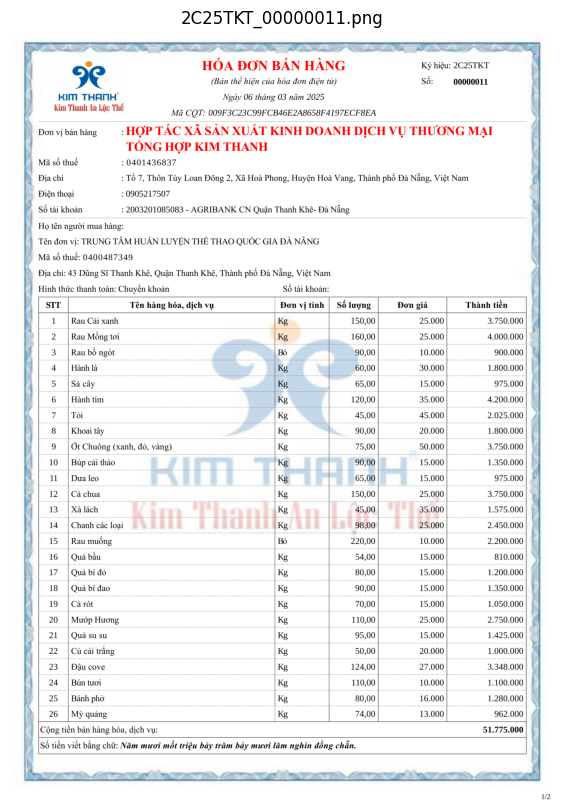

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000011.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "06 tháng 03 năm 2025",
  "Tên khách hàng": "TRUNG TÂM HUẤN LUYỆN THỂ THAO QUỐC GIA ĐÀ NẴNG"
}, {
  "Tên mặt hàng": "Rau Cải xanh",
  "Đơn vị tính": "kg",
  "Số lượng": "150,00",
  "Đơn giá": "25,000",
  "Thành tiền": "3.750.000"
}, {
  "Tên mặt hàng": "Rau Mồng tơi",
  "Đơn vị tính": "kg",
  "Số lượng": "160,00",
  "Đơn giá": "25,000",
  "Thành tiền": "4.000.000"
}, ... ]

Đang xử lý: 2C25TKT_00000012.png


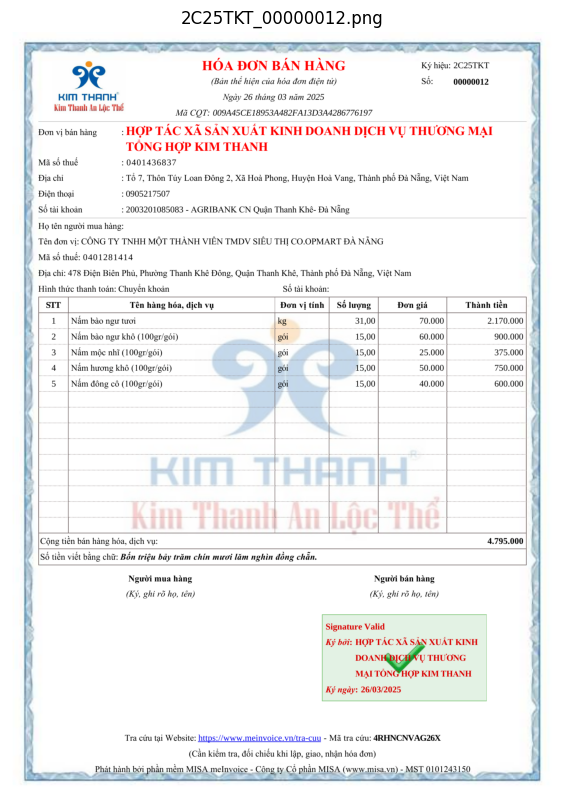

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000012.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "26/03/2025",
    "Tên khách hàng": "CÔNG TY TNHH MỘT THÀNH VIÊN TMDV SIÊU THỊ CO.OPMART ĐÀ NẴNG"
  },
  {
    "Tên mặt hàng": "Nấm bào ngư tươi",
    "Đơn vị tính": "kg",
    "Số lượng": "31,00",
    "Đơn giá": "70.000",
    "Thành tiền": "2.170.000"
  },
  {
    "Tên mặt hàng": "Nấm bào ngư khô (100gr/gói)",
    "Đơn vị tính": "gói",
    "Số lượng": "15,00",
    "Đơn giá": "60.000",
    "Thành tiền": "900.000"
  },
  {
    "Tên mặt hàng": "Nấm mộc nhĩ (100gr/gói)",
    "Đơn vị tính": "gói",
    "Số lượng": "15,00",
 

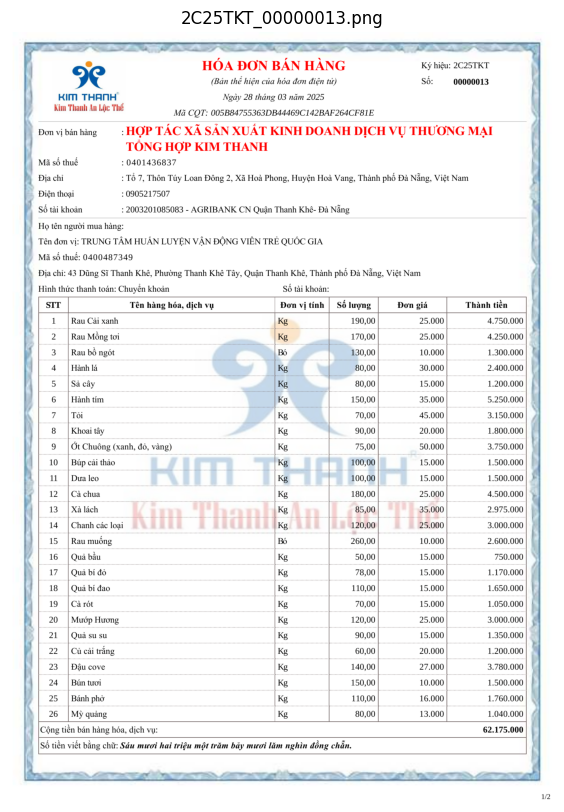

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000013.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "28 tháng 03 năm 2025",
  "Tên khách hàng": "TRUNG TÂM HUẤN LUYỆN VẬN ĐỘNG VIÊN TRẺ QUỐC GIA"
}, {
  "Tên mặt hàng": "Rau Cải xanh",
  "Đơn vị tính": "kg",
  "Số lượng": "190,00",
  "Đơn giá": "25,000",
  "Thành tiền": "4.750,00"
}, {
  "Tên mặt hàng": "Rau Mồng tơi",
  "Đơn vị tính": "kg",
  "Số lượng": "170,00",
  "Đơn giá": "25,000",
  "Thành tiền": "4.250,00"
}, ... ]

Đang xử lý: 2C25TKT_00000014.png


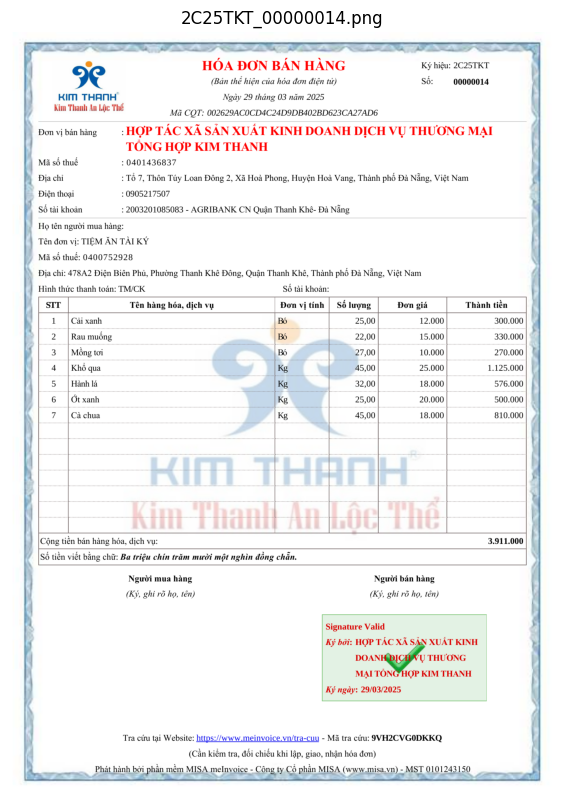

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000014.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "29/03/2025",
    "Tên khách hàng": "TIỆM ĂN TÀI KÝ"
  },
  {
    "Tên mặt hàng": "Cải xanh",
    "Đơn vị tính": "Bó",
    "Số lượng": "25,00",
    "Đơn giá": "12.000",
    "Thành tiền": "300.000"
  },
  {
    "Tên mặt hàng": "Rau muống",
    "Đơn vị tính": "Bó",
    "Số lượng": "22,00",
    "Đơn giá": "15.000",
    "Thành tiền": "330.000"
  },
  {
    "Tên mặt hàng": "Mồng tơi",
    "Đơn vị tính": "Bó",
    "Số lượng": "27,00",
    "Đơn giá": "10.000",
    "Thành tiền": "270.000"
  },
  {
    "Tên mặt hàng": "Khổ qua"

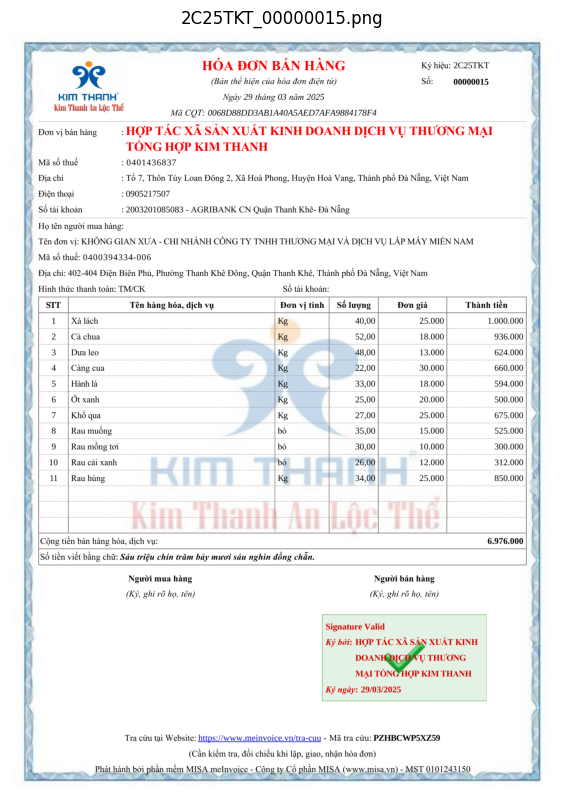

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000015.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "29/03/2025",
    "Tên khách hàng": "KHÔNG GIAN XƯA - CHI NHÁNH CÔNG TY TNHH THƯƠNG MẠI VÀ DỊCH VỤ LẮP MÁY MIỀN NAM"
  },
  {
    "Tên mặt hàng": "Xà lách",
    "Đơn vị tính": "Kg",
    "Số lượng": "40,00",
    "Đơn giá": "25,000",
    "Thành tiền": "1.000.000"
  },
  {
    "Tên mặt hàng": "Cà chua",
    "Đơn vị tính": "Kg",
    "Số lượng": "52,00",
    "Đơn giá": "18,000",
    "Thành tiền": "936.000"
  },
  {
    "Tên mặt hàng": "Dưa leo",
    "Đơn vị tính": "Kg",
    "Số lượng": "48,00",
    "Đơn giá": "13,000",
    

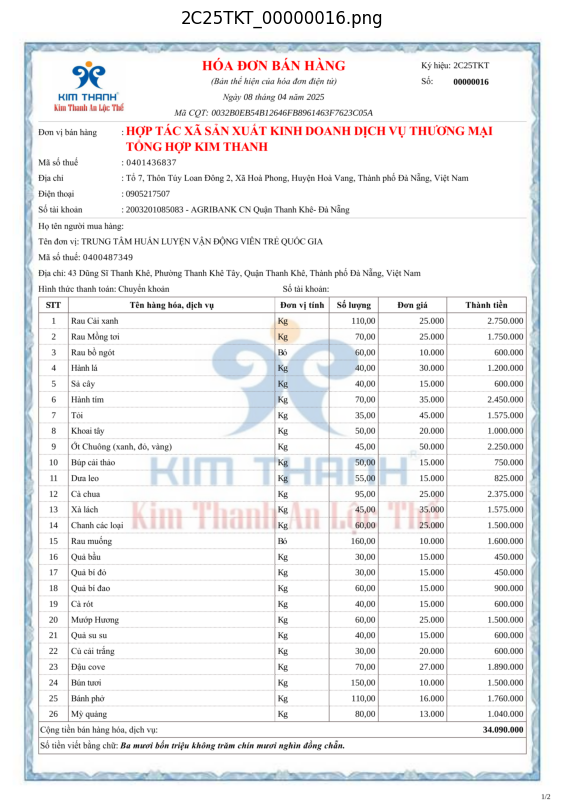

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000016.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "08 tháng 04 năm 2025",
    "Tên khách hàng": "TRUNG TÂM HUẤN LUYỆN VẬN ĐỘNG VIÊN TRẺ QUỐC GIA"
  },
  {
    "Tên mặt hàng": "Rau Cải xanh",
    "Đơn vị tính": "Kg",
    "Số lượng": "110,00",
    "Đơn giá": "25,000",
    "Thành tiền": "2.750.000"
  },
  {
    "Tên mặt hàng": "Rau Mồng tơi",
    "Đơn vị tính": "Kg",
    "Số lượng": "70,00",
    "Đơn giá": "25,000",
    "Thành tiền": "1.750.000"
  },
  {
    "Tên mặt hàng": "Rau bồ ngót",
    "Đơn vị tính": "Bó",
    "Số lượng": "60,00",
    "Đơn giá": "10,000",
    "Thà

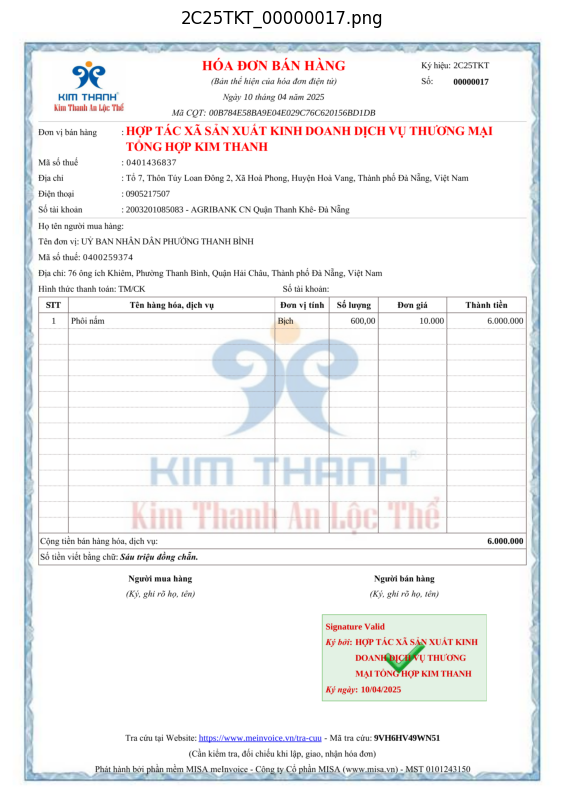

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000017.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "10/04/2025",
  "Tên khách hàng": "ỦY BAN NHÂN DÂN PHƯỜNG THANH BÌNH"
}, {
  "Tên mặt hàng": "Phôi nấm",
  "Đơn vị tính": "Bịch",
  "Số lượng": "600,00",
  "Đơn giá": "10.000",
  "Thành tiền": "6.000.000"
}]

Đang xử lý: 2C25TKT_00000018.png


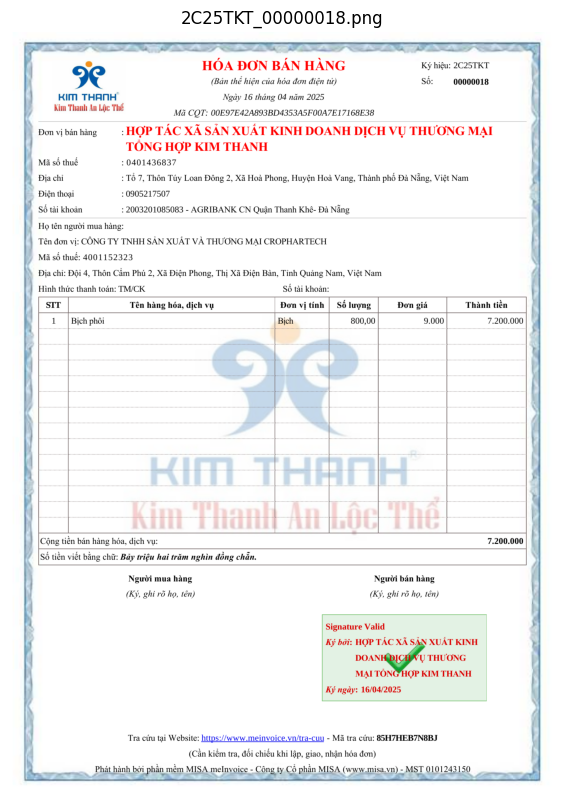

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2C25TKT_00000018.png
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [ 
  {
    "Ngày tạo đơn": "16/04/2025",
    "Tên khách hàng": "CÔNG TY TNHH SẢN XUẤT VÀ THƯƠNG MẠI CROPHATECH"
  }
]

Đang xử lý: facbd6ea-7f1f-42fc-8882-102d84242f07.jpg


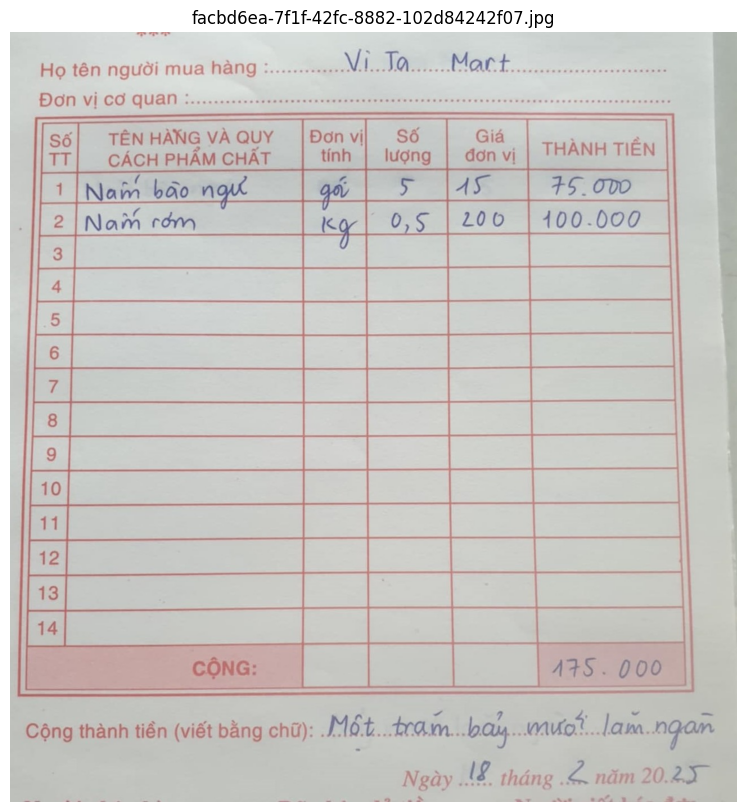

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: facbd6ea-7f1f-42fc-8882-102d84242f07.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "18 tháng 2 năm 2025",
  "Tên khách hàng": "Vị Ta Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "15",
  "Thành tiền": "75.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "0,5",
  "Đơn giá": "200",
  "Thành tiền": "100.000"
}]

Đang xử lý: f6483f50-3afc-4bfe-8c72-d5bda1cd146c.jpg


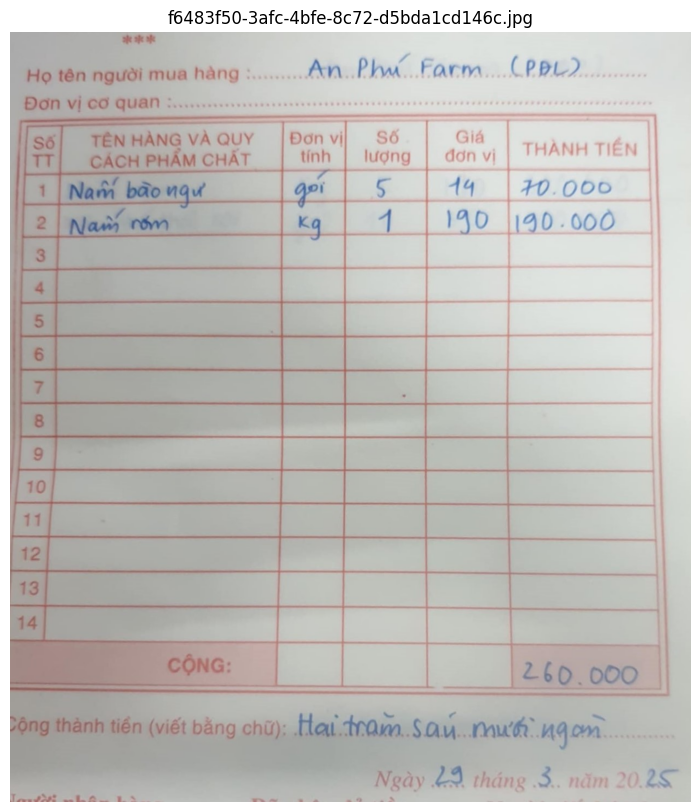

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: f6483f50-3afc-4bfe-8c72-d5bda1cd146c.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "29 tháng 3 năm 2025",
  "Tên khách hàng": "An Phú Farm (PDL)"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 14,
  "Thành tiền": 70000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 190,
  "Thành tiền": 190000
}]

Đang xử lý: f28a5362-eb8b-415f-be0c-cebf17d8a268.jpg


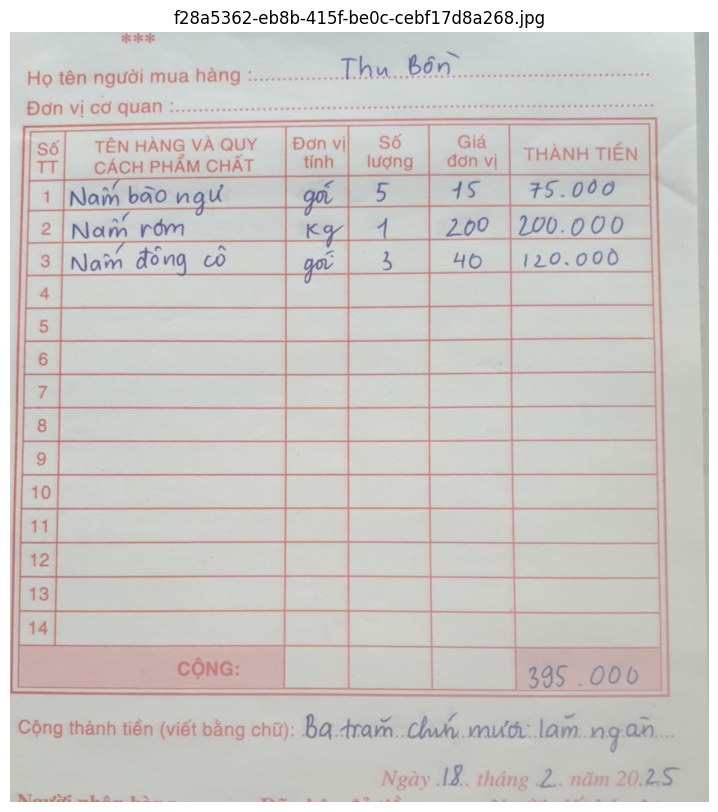

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: f28a5362-eb8b-415f-be0c-cebf17d8a268.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "18 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 15,
  "Thành tiền": 75000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 200,
  "Thành tiền": 200000
}, {
  "Tên mặt hàng": "Nấm đông cô",
  "Đơn vị tính": "gói",
  "Số lượng": 3,
  "Đơn giá": 40,
  "Thành tiền": 120000
}]

Đang xử lý: f0b95d6a-9eca-41b5-b62c-50f43e4e948c.jpg


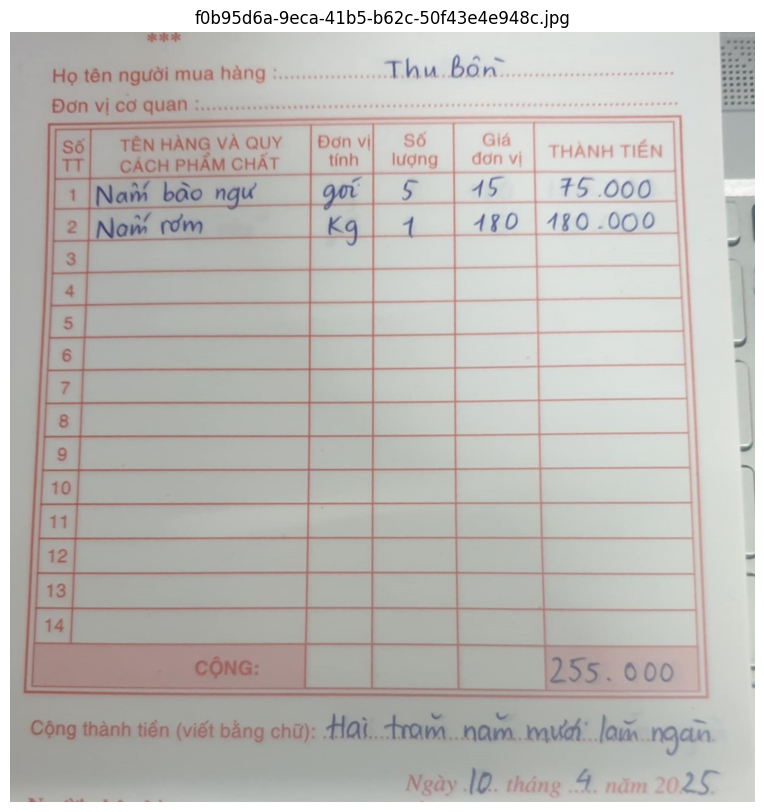

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: f0b95d6a-9eca-41b5-b62c-50f43e4e948c.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "10 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bôn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "15",
  "Thành tiền": "75.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "180",
  "Thành tiền": "180.000"
}]

Đang xử lý: e6a39596-0a55-4ea6-81f4-4b9460674e1f.jpg


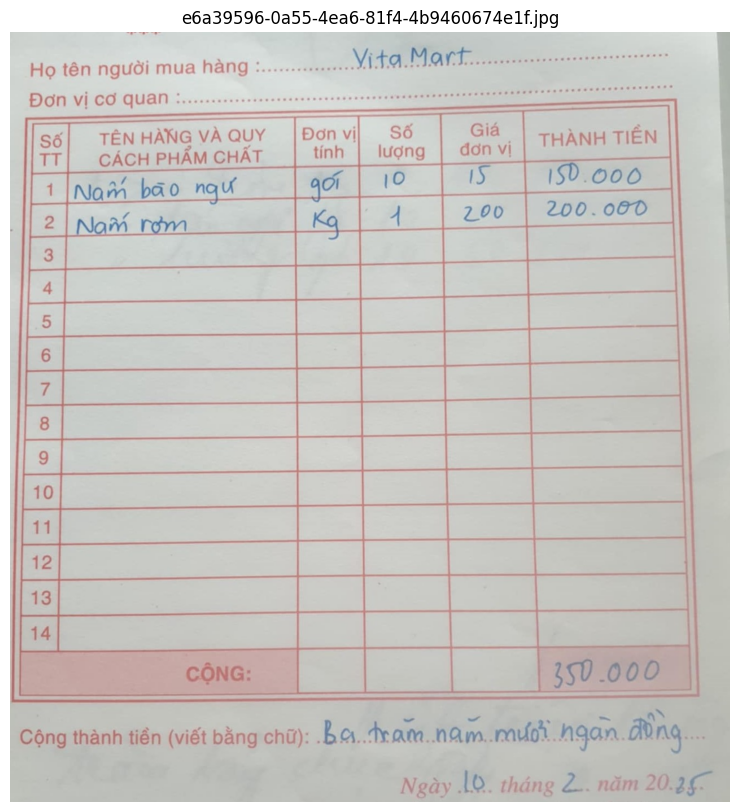

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: e6a39596-0a55-4ea6-81f4-4b9460674e1f.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "10 tháng 2 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 10,
  "Đơn giá": 15,
  "Thành tiền": 150000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 200,
  "Thành tiền": 200000
}]

Đang xử lý: e2c2489b-caa0-4269-b398-9699169b5863.jpg


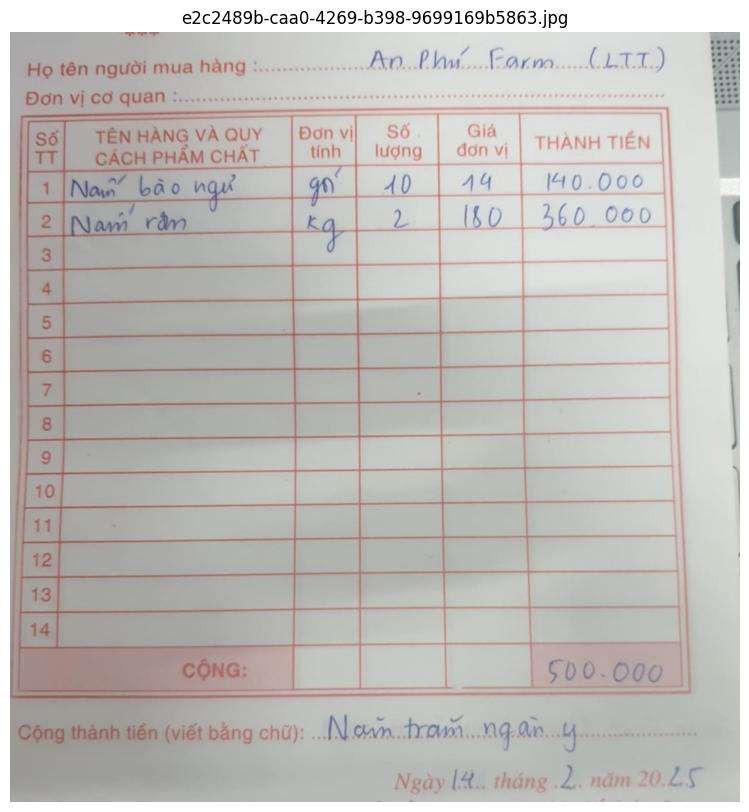

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: e2c2489b-caa0-4269-b398-9699169b5863.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "14 tháng 2 năm 2025",
  "Tên khách hàng": "An Phú Farm (LTT)"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 10,
  "Đơn giá": 14,
  "Thành tiền": 140000
}, {
  "Tên mặt hàng": "Nấm răm",
  "Đơn vị tính": "kg",
  "Số lượng": 2,
  "Đơn giá": 180,
  "Thành tiền": 360000
}]

Đang xử lý: d813d42f-e4db-4065-b996-e30322b14b83.jpg


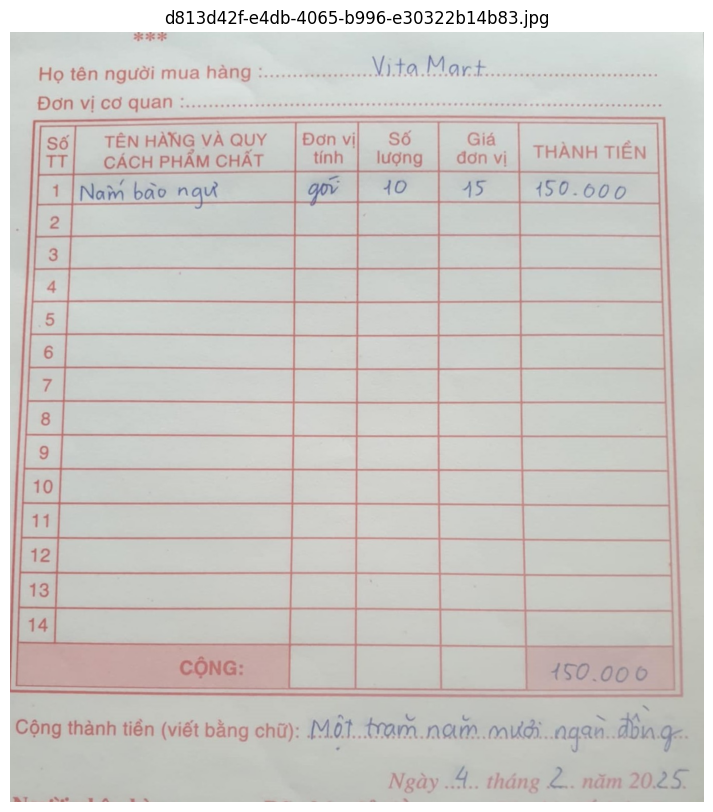

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: d813d42f-e4db-4065-b996-e30322b14b83.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{"Ngày tạo đơn": "4 tháng 2 năm 2025", "Tên khách hàng": "Vita Mart"}, {"Tên mặt hàng": "Nấm bào ngư", "Đơn vị tính": "gói", "Số lượng": 10, "Đơn giá": 15, "Thành tiền": 150000}]

Đang xử lý: d59d7f80-8e65-46e5-ba91-c04f66e79a06.jpg


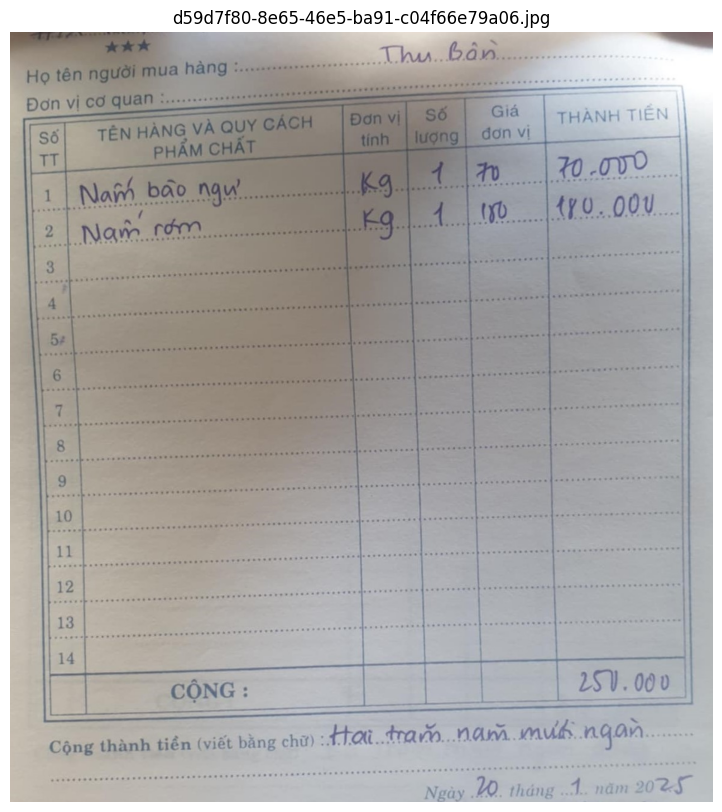

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: d59d7f80-8e65-46e5-ba91-c04f66e79a06.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "20 tháng 1 năm 2025",
  "Tên khách hàng": "Thu Bàn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "70.000",
  "Thành tiền": "70.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "180.000",
  "Thành tiền": "180.000"
}]

Đang xử lý: d9f0d348-4b97-40ff-a7bd-cdd28cd6277f.jpg


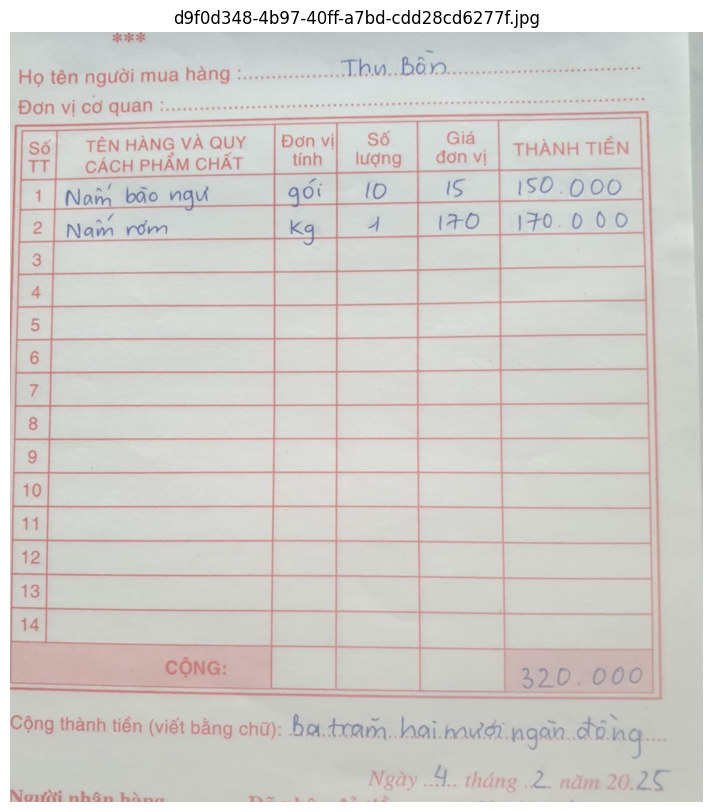

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: d9f0d348-4b97-40ff-a7bd-cdd28cd6277f.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "4 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Gói",
  "Số lượng": 10,
  "Đơn giá": 15,
  "Thành tiền": 150000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 170,
  "Thành tiền": 170000
}]

Đang xử lý: d5bf6b6c-beea-43bd-9166-8e1d32f734b1.jpg


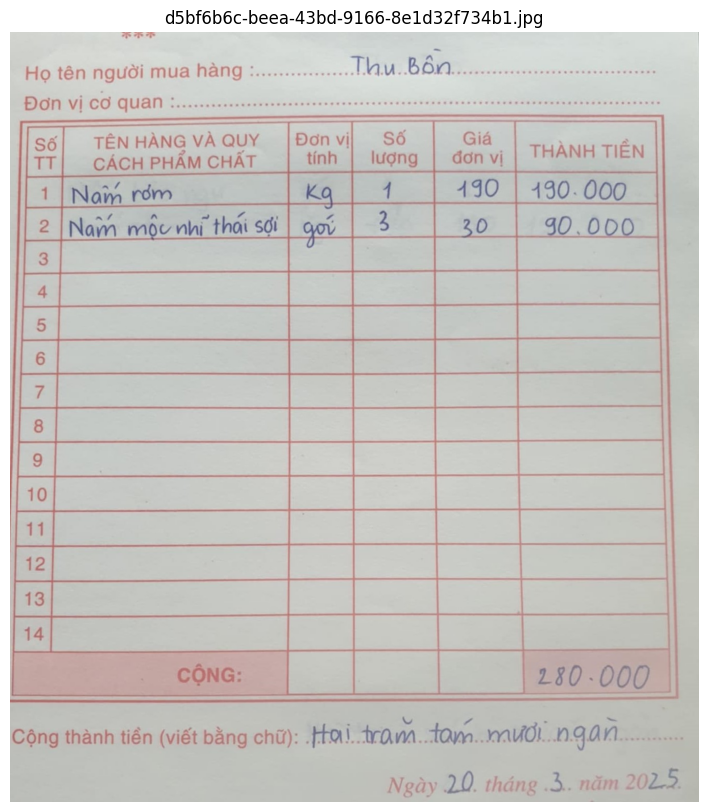

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: d5bf6b6c-beea-43bd-9166-8e1d32f734b1.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "20 tháng 3 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 190,
  "Thành tiền": 190000
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ thái sợi",
  "Đơn vị tính": "Gói",
  "Số lượng": 3,
  "Đơn giá": 30,
  "Thành tiền": 90000
}]

Đang xử lý: d3e30ced-74f9-4ea8-91f5-6a19806ab871.jpg


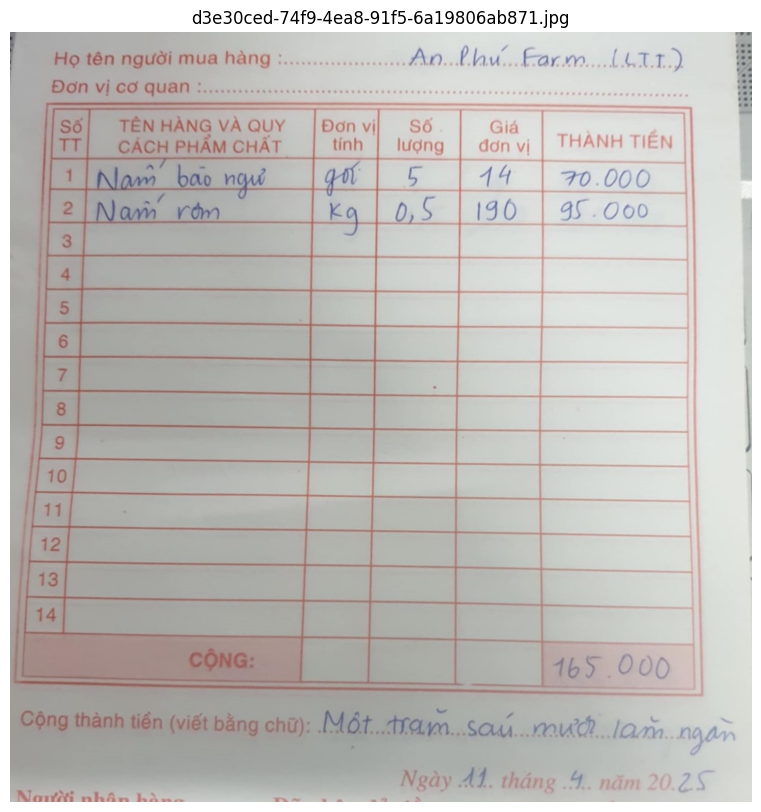

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: d3e30ced-74f9-4ea8-91f5-6a19806ab871.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "11 tháng 4 năm 2025",
  "Tên khách hàng": "An Phú Farm (LTT)"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "14",
  "Thành tiền": "70.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "0,5",
  "Đơn giá": "190",
  "Thành tiền": "95.000"
}]

Đang xử lý: d0f3e35e-1ad5-4f51-b9ee-d0b7def2d268.jpg


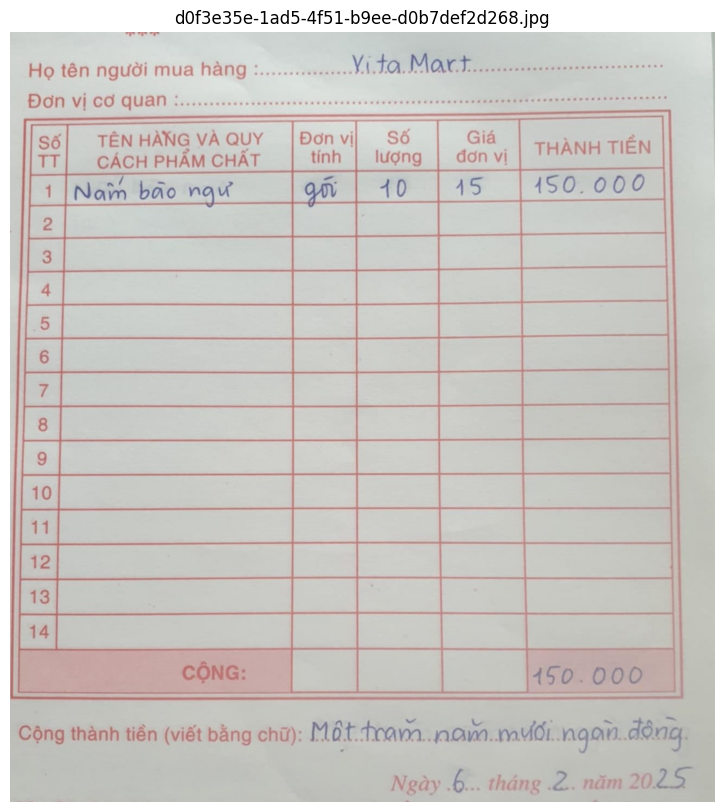

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: d0f3e35e-1ad5-4f51-b9ee-d0b7def2d268.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "6 tháng 2 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 10,
  "Đơn giá": 15,
  "Thành tiền": 150000
}]

Đang xử lý: ce10d73b-d9f6-4f6d-817f-13847ce62b40.jpg


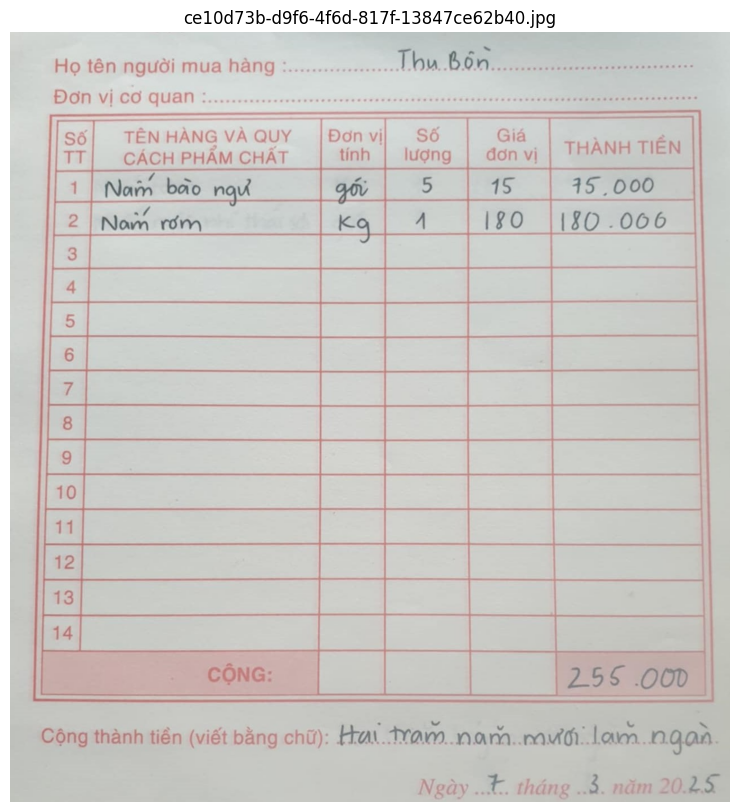

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: ce10d73b-d9f6-4f6d-817f-13847ce62b40.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "7 tháng 3 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 15,
  "Thành tiền": 75000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}]

Đang xử lý: c4161d24-c9d3-4fd8-abf8-346977e0e60e.jpg


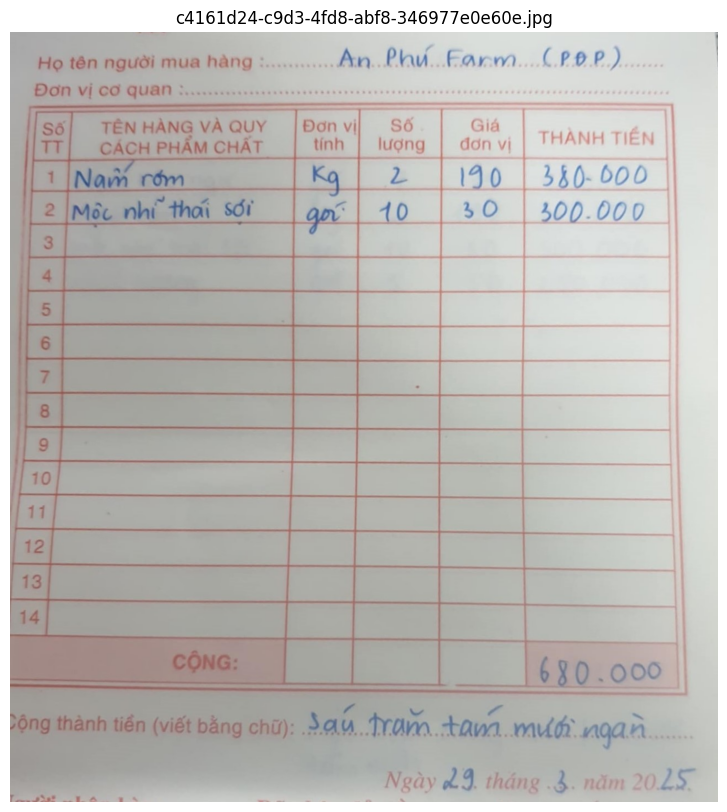

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: c4161d24-c9d3-4fd8-abf8-346977e0e60e.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "29 tháng 3 năm 2025",
  "Tên khách hàng": "An Phú Farm (PĐP)"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": "2",
  "Đơn giá": "190",
  "Thành tiền": "380.000"
}, {
  "Tên mặt hàng": "Mộc nhĩ thái sợi",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "30",
  "Thành tiền": "300.000"
}]

Đang xử lý: c4f638b9-7f90-451e-b1cd-276d5b7cc49c.jpg


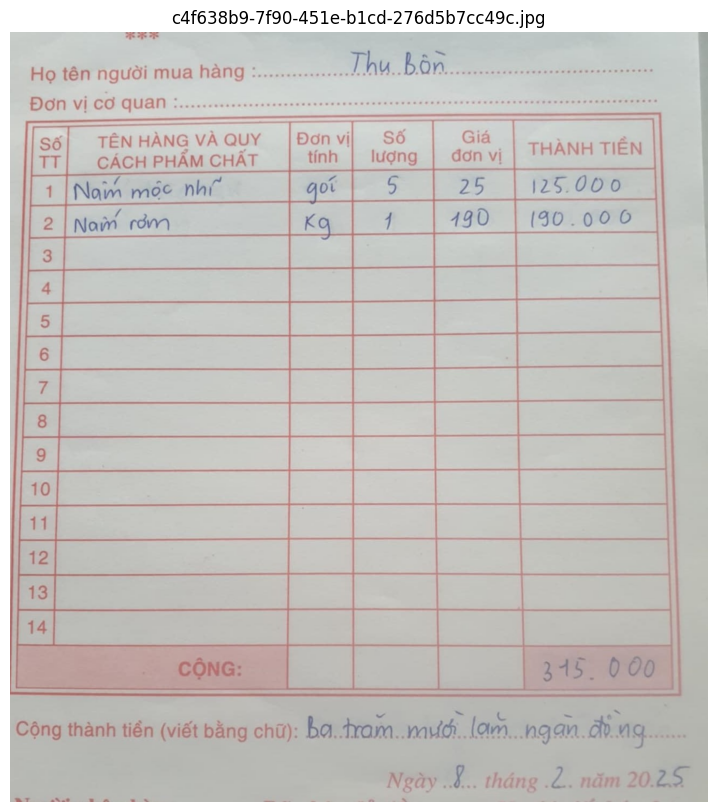

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: c4f638b9-7f90-451e-b1cd-276d5b7cc49c.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "8 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 25,
  "Thành tiền": 125000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 190,
  "Thành tiền": 190000
}]

Đang xử lý: c4ef74f1-5b8c-4174-86bf-28031f6bdc5d.jpg


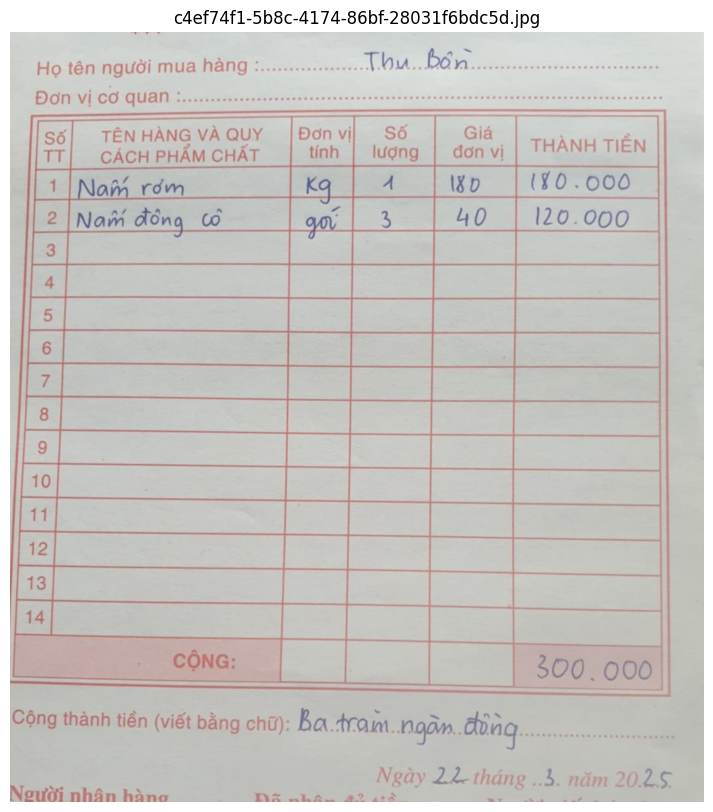

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: c4ef74f1-5b8c-4174-86bf-28031f6bdc5d.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "22 tháng 3 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}, {
  "Tên mặt hàng": "Nấm đông cô",
  "Đơn vị tính": "gói",
  "Số lượng": 3,
  "Đơn giá": 40,
  "Thành tiền": 120000
}]

Đang xử lý: bfe474ff-e1a4-4011-9cfc-568d6b7cb90c.jpg


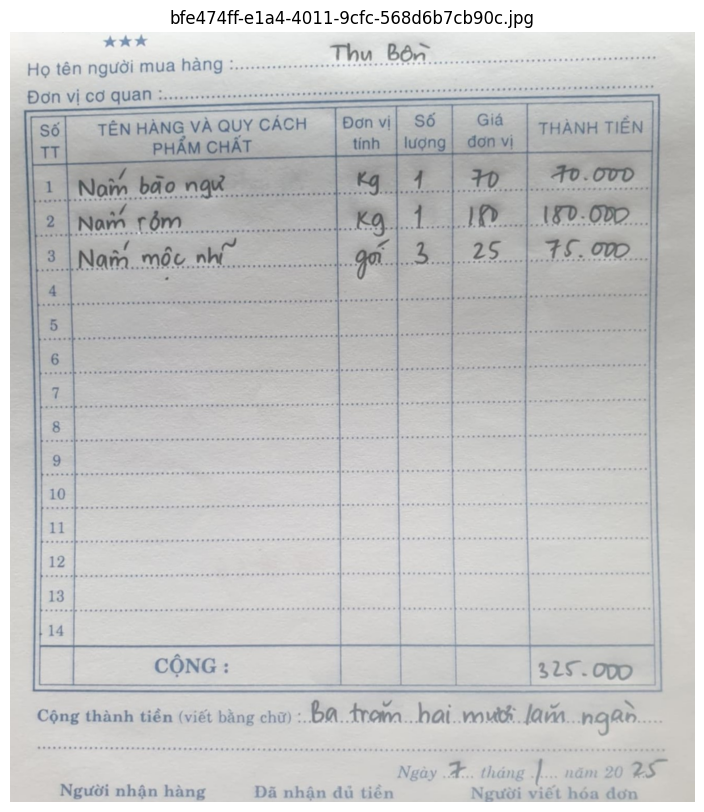

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: bfe474ff-e1a4-4011-9cfc-568d6b7cb90c.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "Ngày tạo đơn",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "70",
  "Thành tiền": "70.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "180",
  "Thành tiền": "180.000"
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ",
  "Đơn vị tính": "gói",
  "Số lượng": "3",
  "Đơn giá": "25",
  "Thành tiền": "75.000"
}]

Đang xử lý: bcfb5749-3c24-4035-a7c9-c5227596dd47.jpg


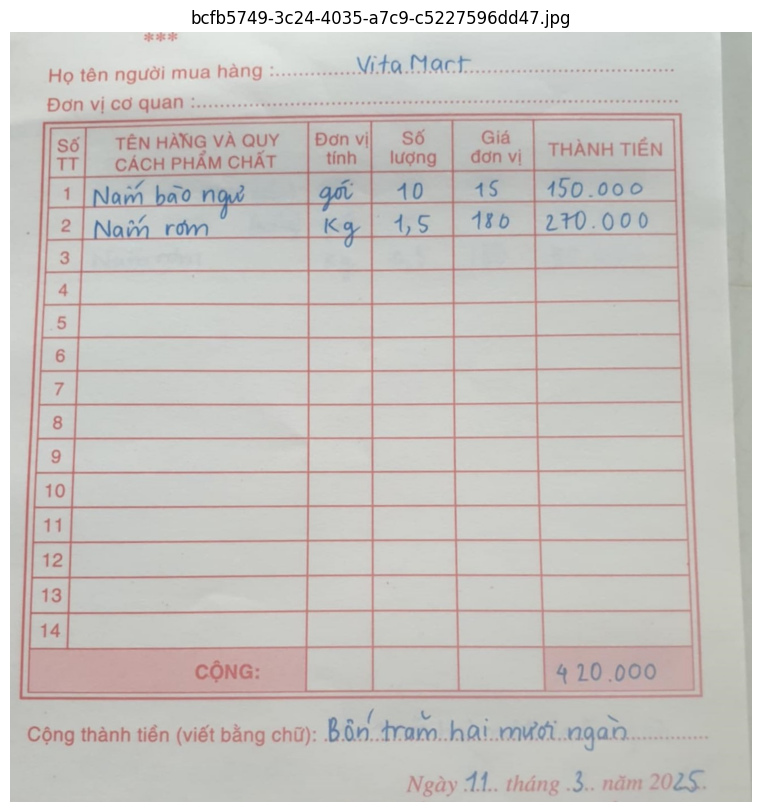

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: bcfb5749-3c24-4035-a7c9-c5227596dd47.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "11 tháng 3 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "15",
  "Thành tiền": "150.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1,5",
  "Đơn giá": "180",
  "Thành tiền": "270.000"
}]

Đang xử lý: b7177e19-d437-442d-b690-5828da8d56c2.jpg


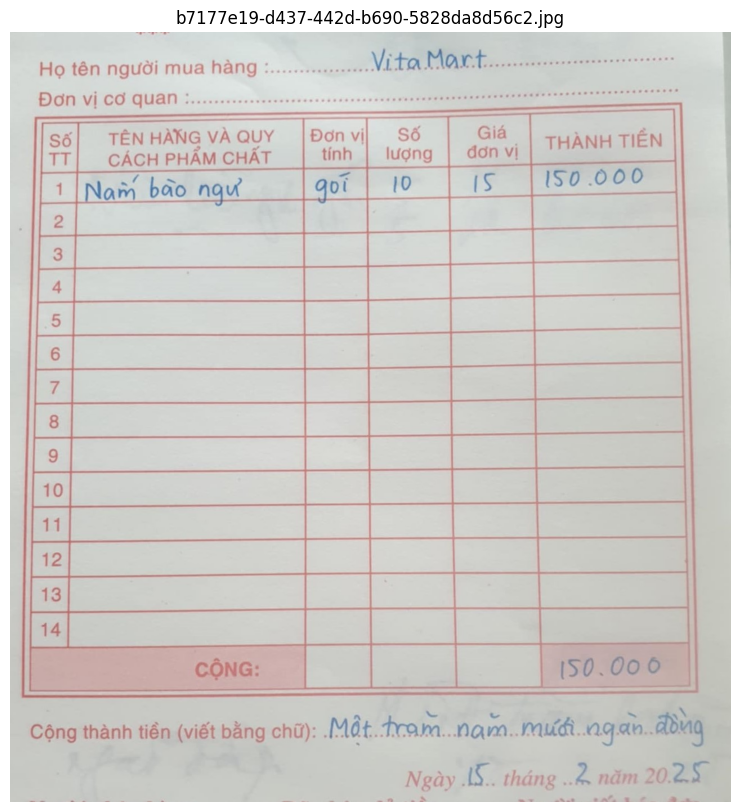

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: b7177e19-d437-442d-b690-5828da8d56c2.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "15 tháng 2 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 10,
  "Đơn giá": 15,
  "Thành tiền": 150000
}]

Đang xử lý: b029d22d-5c74-46c7-b14a-747431f3d4c4.jpg


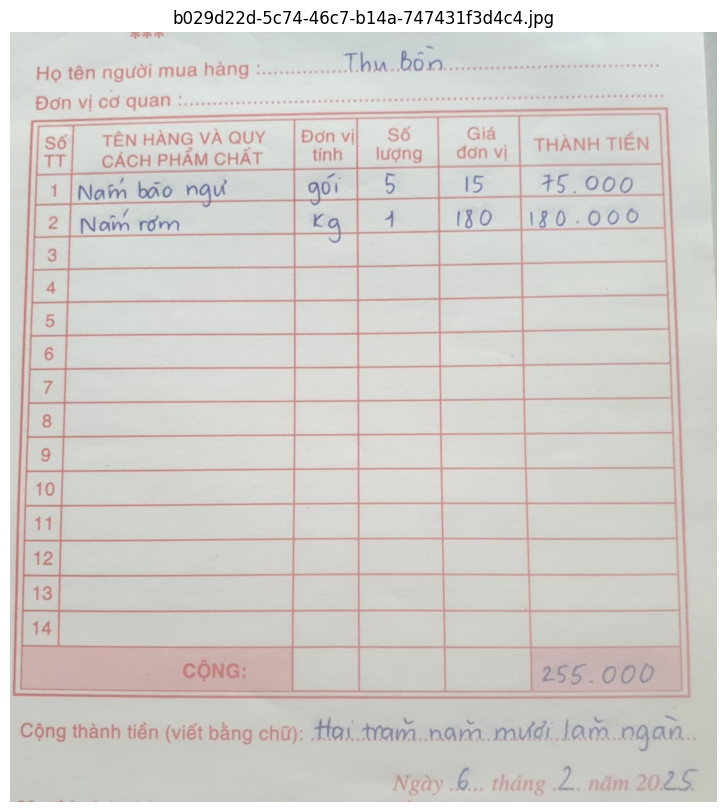

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: b029d22d-5c74-46c7-b14a-747431f3d4c4.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "6 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 15,
  "Thành tiền": 75000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}]

Đang xử lý: b7c3378e-b32f-44cb-8902-765902c51957.jpg


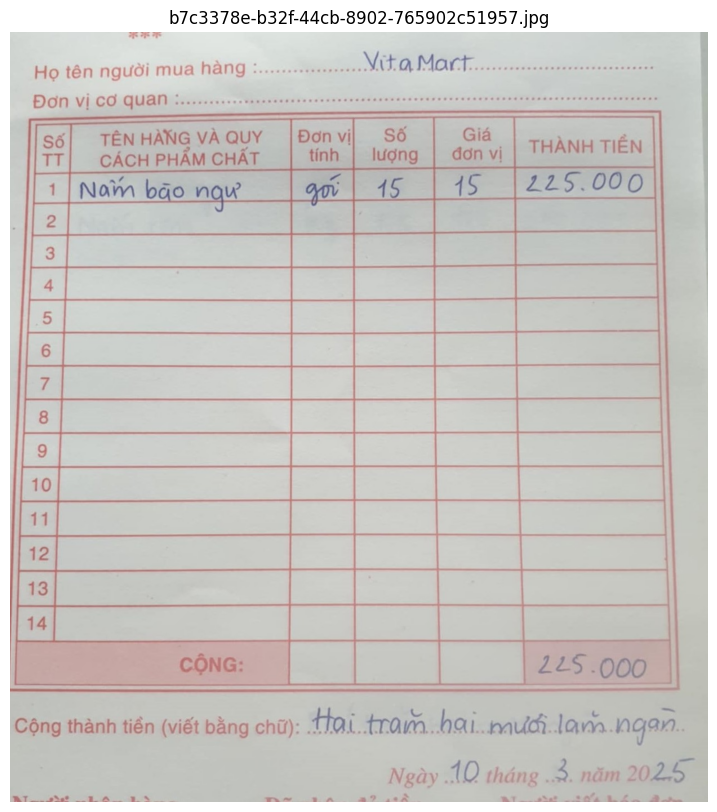

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: b7c3378e-b32f-44cb-8902-765902c51957.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "10 tháng 3 năm 2025",
  "Tên khách hàng": "VitaMart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "15",
  "Đơn giá": "15",
  "Thành tiền": "225.000"
}]

Đang xử lý: b3a6cea8-db3e-4c42-ab35-0f432e1d7054.jpg


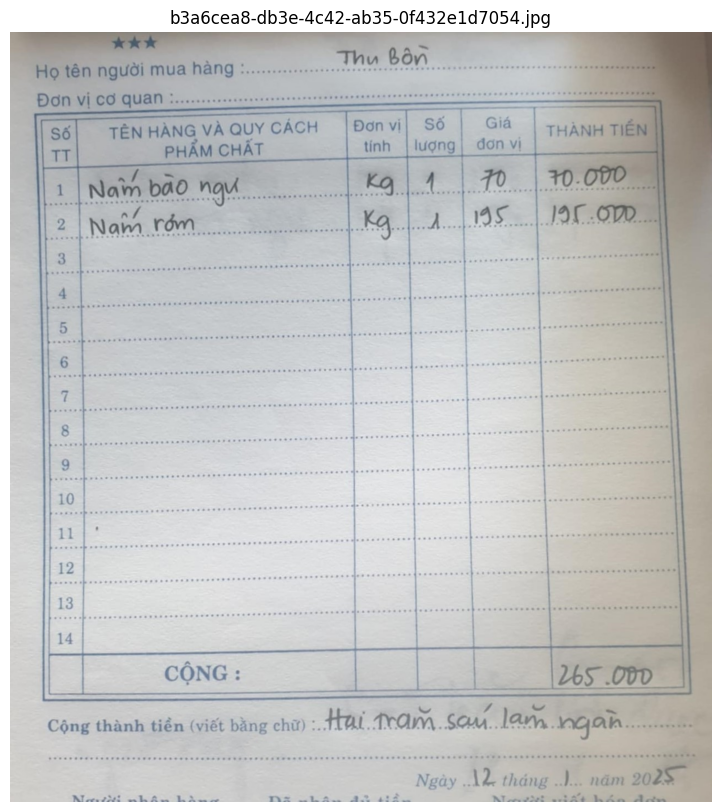

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: b3a6cea8-db3e-4c42-ab35-0f432e1d7054.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "12 tháng 1 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "70",
  "Thành tiền": "70.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "195",
  "Thành tiền": "195.000"
}]

Đang xử lý: a5812640-27ec-45ee-b788-6f89daf10938.jpg


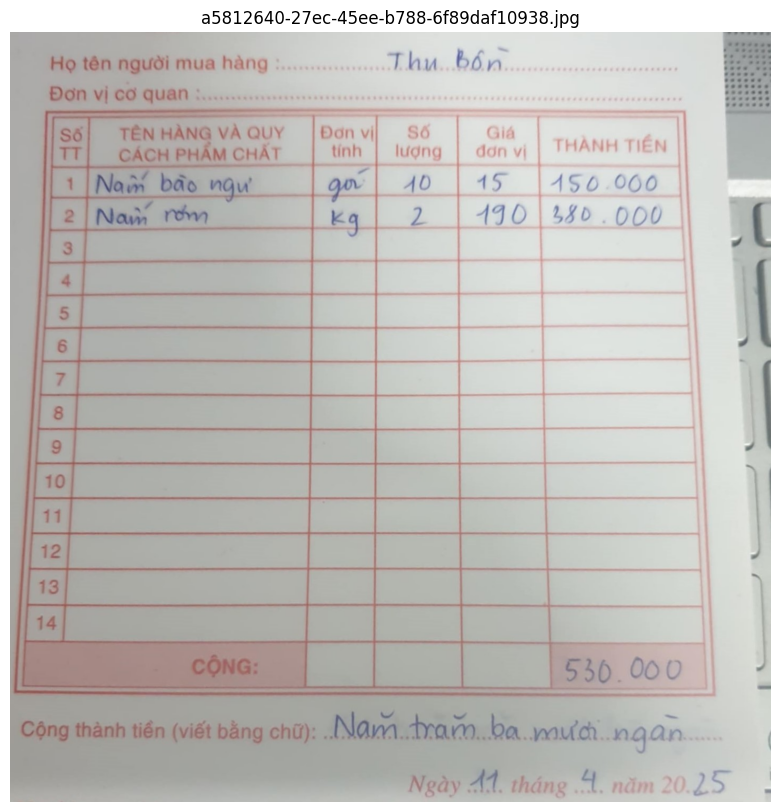

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: a5812640-27ec-45ee-b788-6f89daf10938.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "11 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "15",
  "Thành tiền": "150.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "2",
  "Đơn giá": "190",
  "Thành tiền": "380.000"
}]

Đang xử lý: a66597d5-48f8-45eb-b623-77b0ae119419.jpg


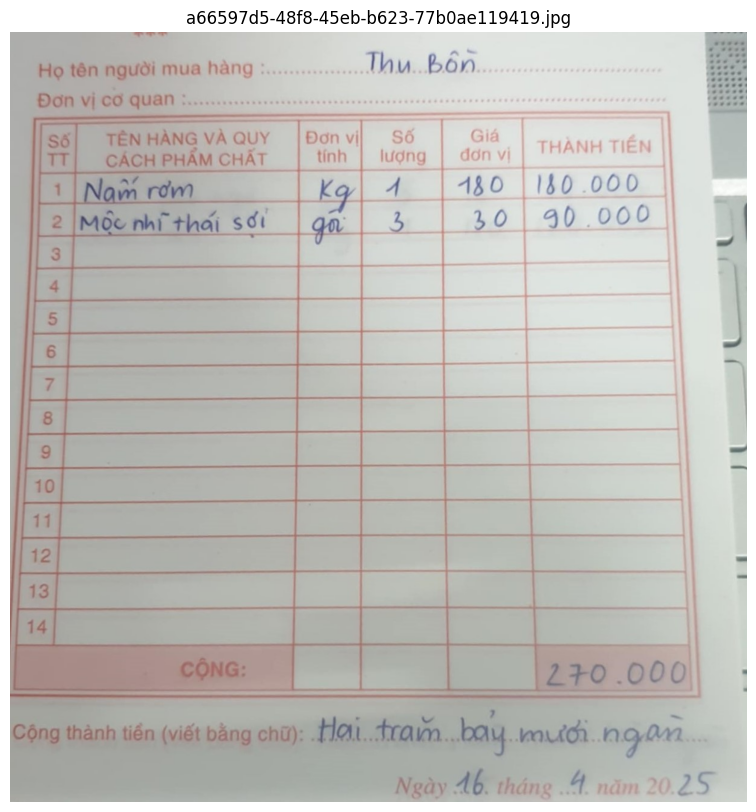

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: a66597d5-48f8-45eb-b623-77b0ae119419.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "16 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}, {
  "Tên mặt hàng": "Mộc nhĩ thái sợi",
  "Đơn vị tính": "gói",
  "Số lượng": 3,
  "Đơn giá": 30,
  "Thành tiền": 90000
}]

Đang xử lý: 32269049-c53c-451b-8700-79efbf9a09c9.jpg


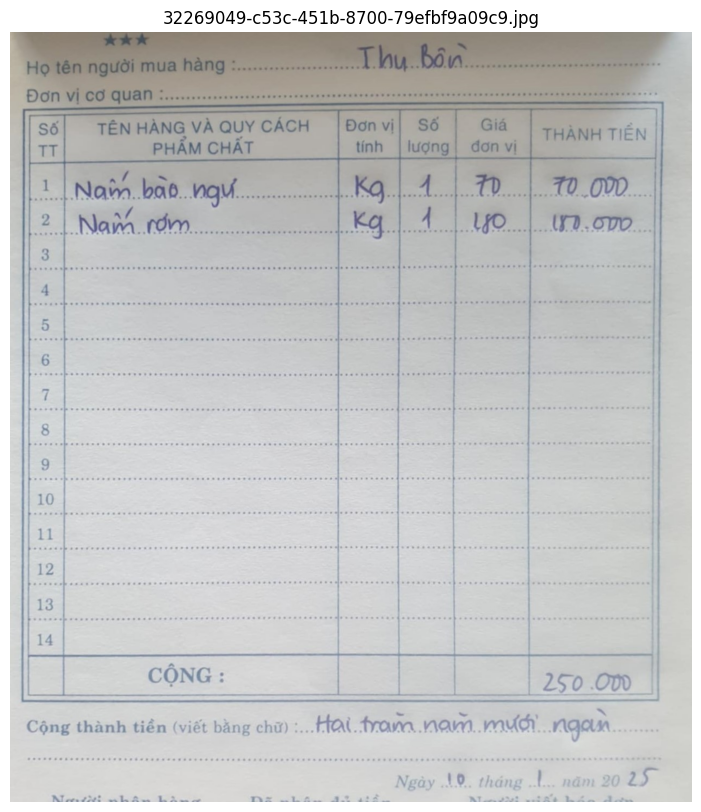

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 32269049-c53c-451b-8700-79efbf9a09c9.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "10 tháng 1 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 70,
  "Thành tiền": 70000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}]

Đang xử lý: 938604a0-7c67-41f3-a2e1-8e9b09676894.jpg


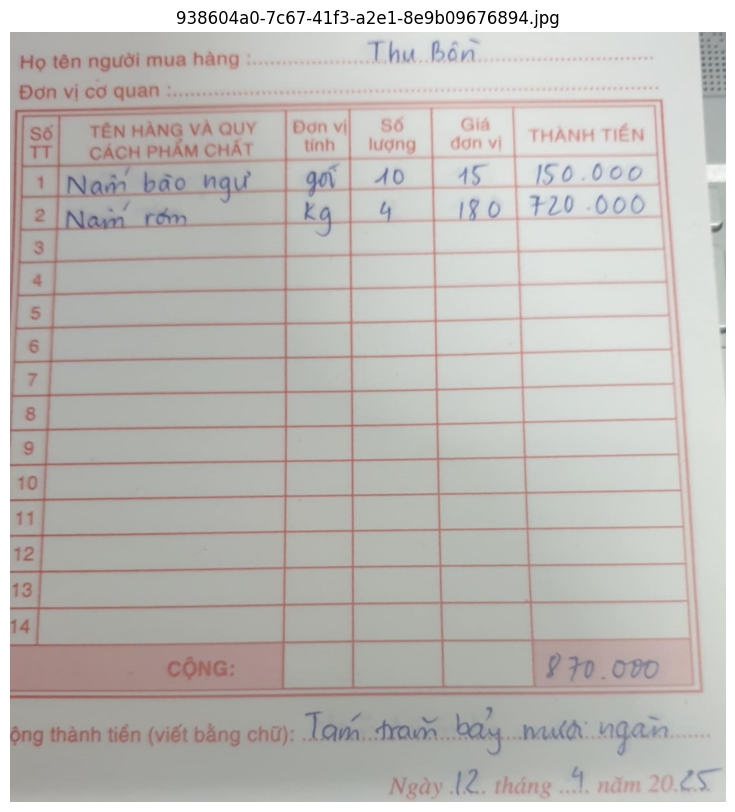

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 938604a0-7c67-41f3-a2e1-8e9b09676894.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "12 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "15",
  "Thành tiền": "150.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "4",
  "Đơn giá": "180",
  "Thành tiền": "720.000"
}]

Đang xử lý: 241292d9-2848-4d8d-a4b9-a3ada72f76a7.jpg


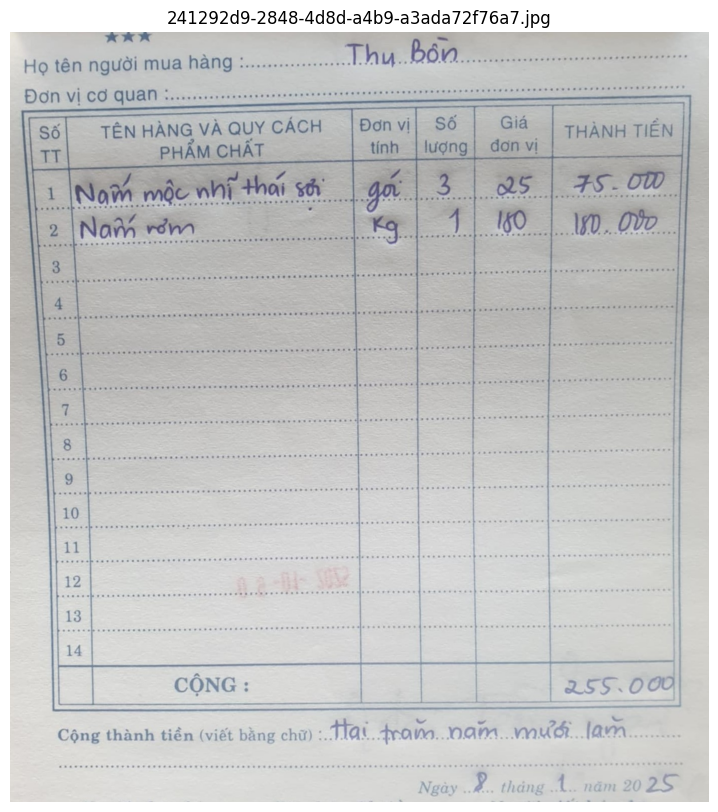

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 241292d9-2848-4d8d-a4b9-a3ada72f76a7.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "8 tháng 1 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ thái sợi",
  "Đơn vị tính": "gói",
  "Số lượng": "3",
  "Đơn giá": "25",
  "Thành tiền": "75.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "180",
  "Thành tiền": "180.000"
}]

Đang xử lý: 86388bfa-bc4c-4705-a161-ecf92a61db0c.jpg


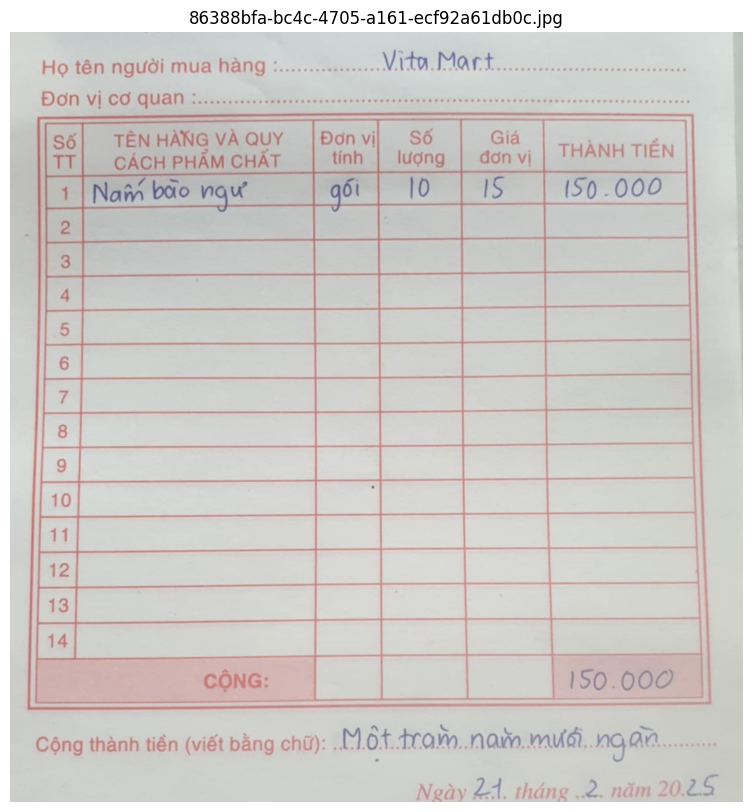

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 86388bfa-bc4c-4705-a161-ecf92a61db0c.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "21 tháng 2 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 10,
  "Đơn giá": 15,
  "Thành tiền": 150000
}]

Đang xử lý: 63587a01-8bc8-48fe-8b6d-409b1f11733d.jpg


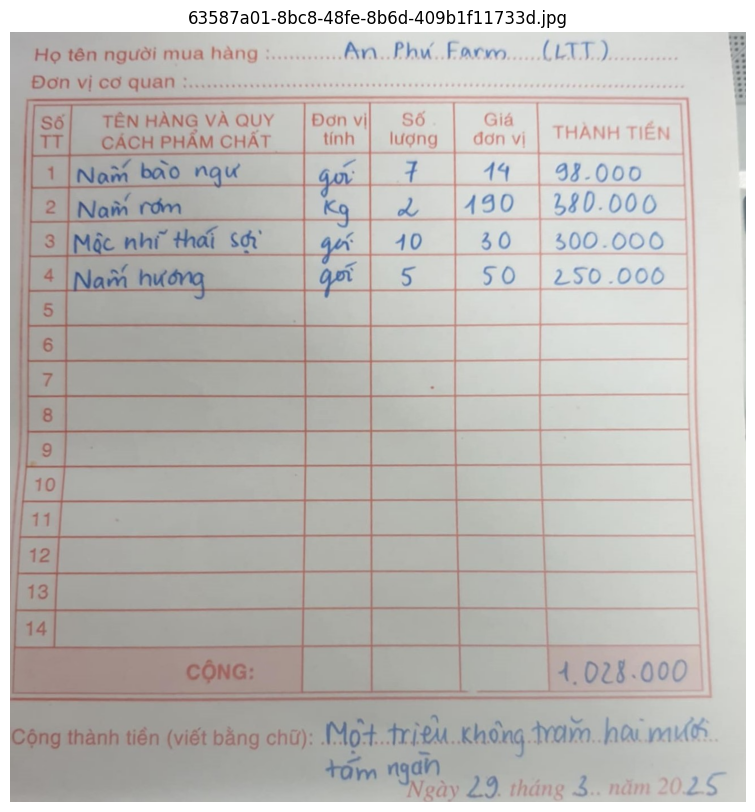

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 63587a01-8bc8-48fe-8b6d-409b1f11733d.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "29 tháng 3 năm 2025",
  "Tên khách hàng": "An Phú Farm (LTT)"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "7",
  "Đơn giá": "14",
  "Thành tiền": "98.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "2",
  "Đơn giá": "190",
  "Thành tiền": "380.000"
}, {
  "Tên mặt hàng": "Mộc nhĩ thái sợi",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "30",
  "Thành tiền": "300.000"
}, {
  "Tên mặt hàng": "Nấm hương",
  "Đơn vị tính": "gói",
  "Số lư

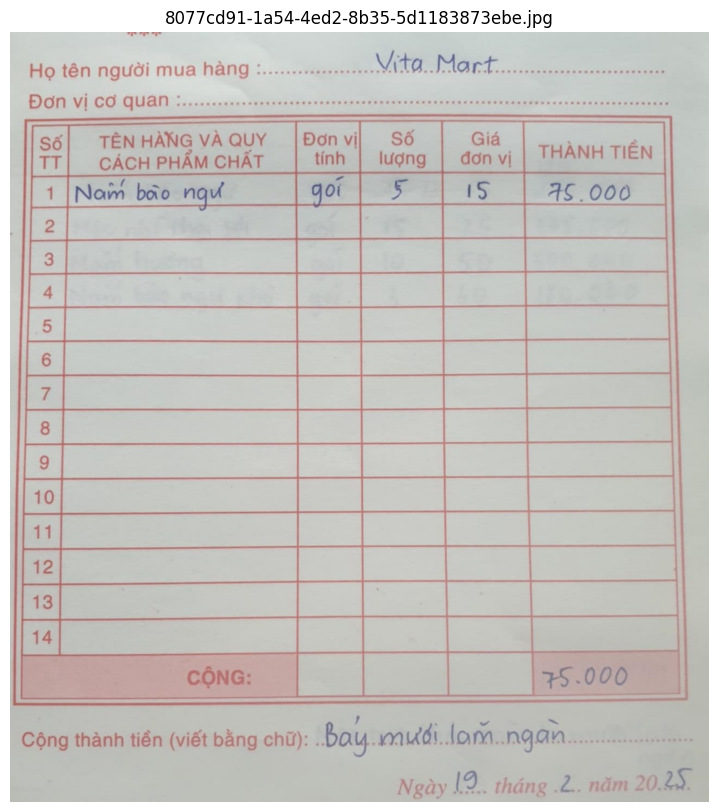

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 8077cd91-1a54-4ed2-8b35-5d1183873ebe.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "19 tháng 2 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "15",
  "Thành tiền": "75.000"
}]

Đang xử lý: 5054a834-8974-4329-9647-cca31bdba5ed.jpg


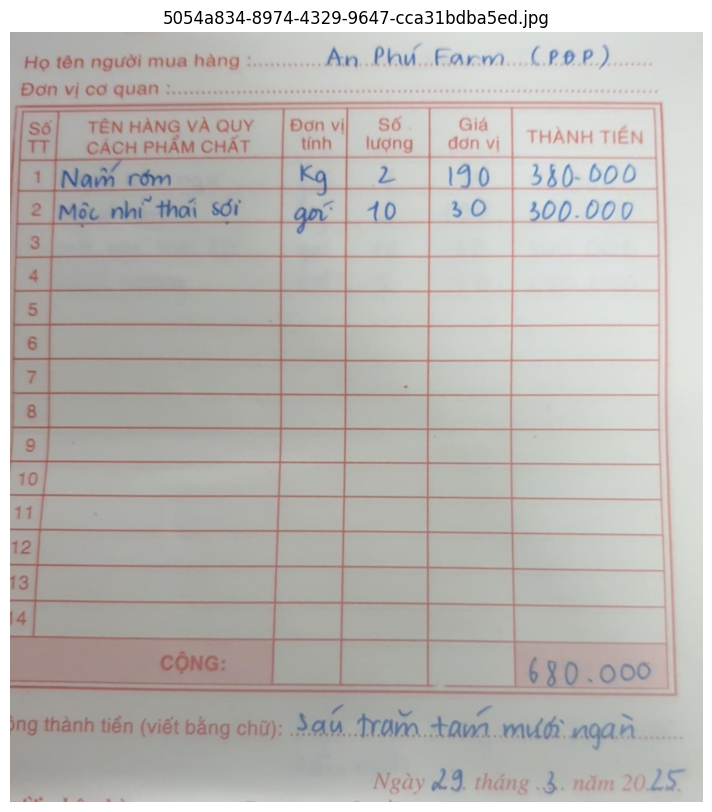

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 5054a834-8974-4329-9647-cca31bdba5ed.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "29 tháng 3 năm 2025",
  "Tên khách hàng": "An Phú Farm (PDP)"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": "2",
  "Đơn giá": "190",
  "Thành tiền": "380.000"
}, {
  "Tên mặt hàng": "Mộc nhĩ thái sợi",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "30",
  "Thành tiền": "300.000"
}]

Đang xử lý: 4426c60f-d051-40df-a6c7-3280765e7df4.jpg


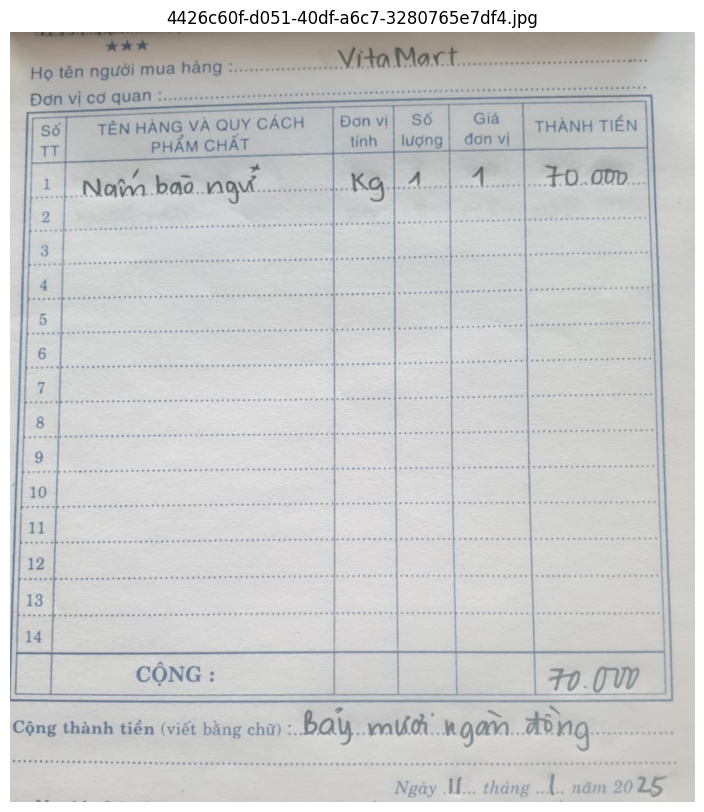

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 4426c60f-d051-40df-a6c7-3280765e7df4.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "11 tháng 1 năm 2025",
  "Tên khách hàng": "VitaMart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "70.000",
  "Thành tiền": "70.000"
}]

Đang xử lý: 2438d769-2ae7-4820-9fca-f2cdcba16f25.jpg


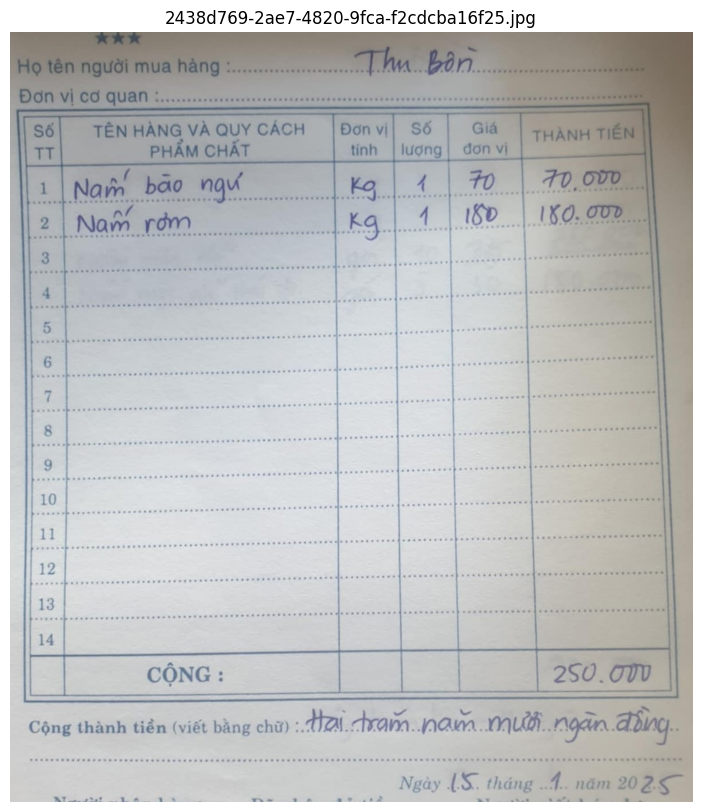

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2438d769-2ae7-4820-9fca-f2cdcba16f25.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "15 tháng 1 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 70,
  "Thành tiền": 70000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}]

Đang xử lý: 993e59cc-5407-4991-ab35-d4491103f36e.jpg


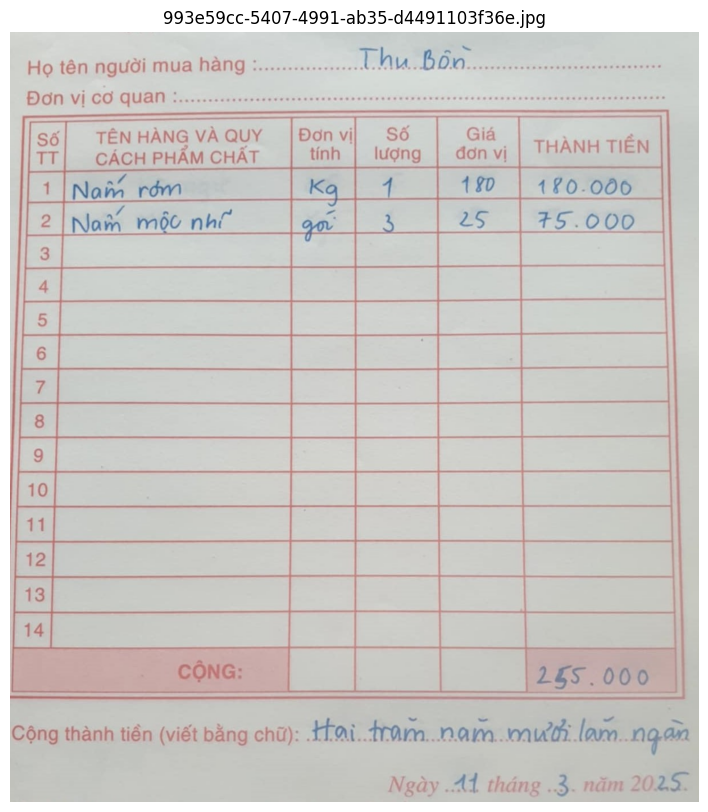

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 993e59cc-5407-4991-ab35-d4491103f36e.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "11 tháng 3 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "180",
  "Thành tiền": "180.000"
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ",
  "Đơn vị tính": "gói",
  "Số lượng": "3",
  "Đơn giá": "25",
  "Thành tiền": "75.000"
}]

Đang xử lý: 847d8ca3-48e0-4000-bced-7200c2215d2f.jpg


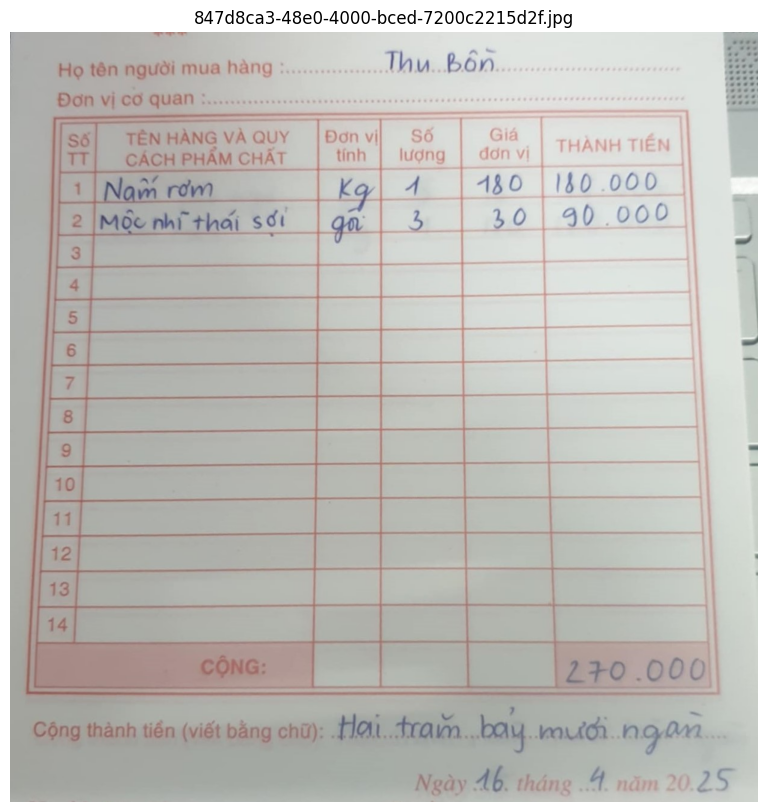

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 847d8ca3-48e0-4000-bced-7200c2215d2f.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "16 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "180",
  "Thành tiền": "180.000"
}, {
  "Tên mặt hàng": "Mộc nhĩ thái sợi",
  "Đơn vị tính": "gói",
  "Số lượng": "3",
  "Đơn giá": "30",
  "Thành tiền": "90.000"
}]

Đang xử lý: 828fa5b4-3d9c-41de-91aa-9d5fefac928d.jpg


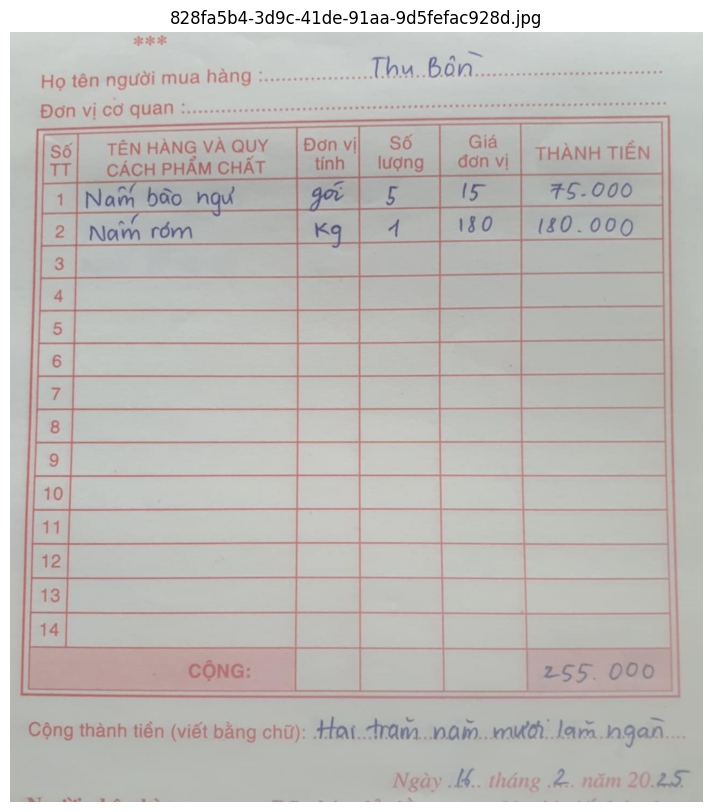

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 828fa5b4-3d9c-41de-91aa-9d5fefac928d.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "16 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "15",
  "Thành tiền": "75.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "180",
  "Thành tiền": "180.000"
}]

Đang xử lý: 99bb4950-1df1-49d7-96dc-61e36c9d6126.jpg


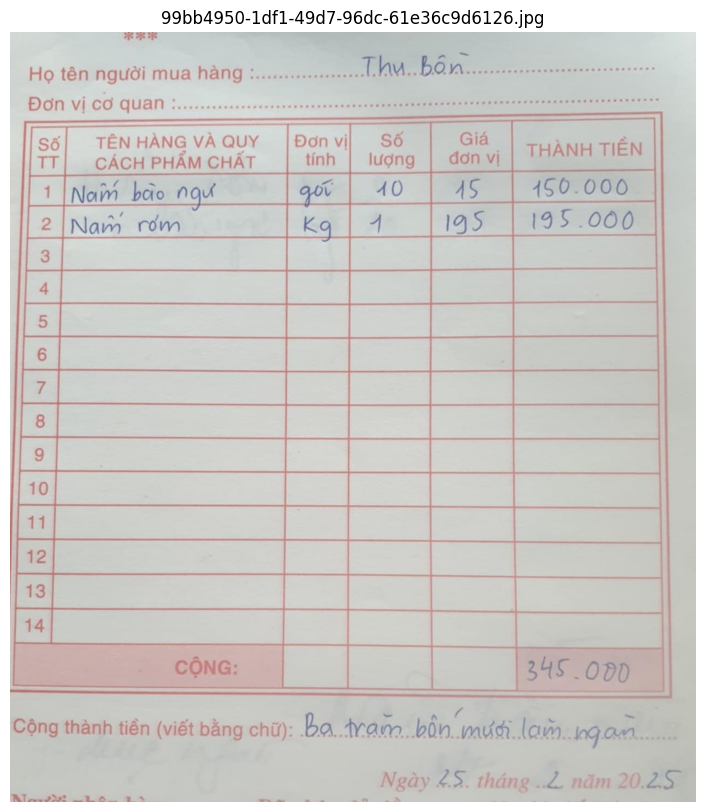

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 99bb4950-1df1-49d7-96dc-61e36c9d6126.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "25 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Gói",
  "Số lượng": 10,
  "Đơn giá": 15,
  "Thành tiền": 150000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 195,
  "Thành tiền": 195000
}]

Đang xử lý: 93dc57e0-d383-4598-bc6c-30e26c850c7b.jpg


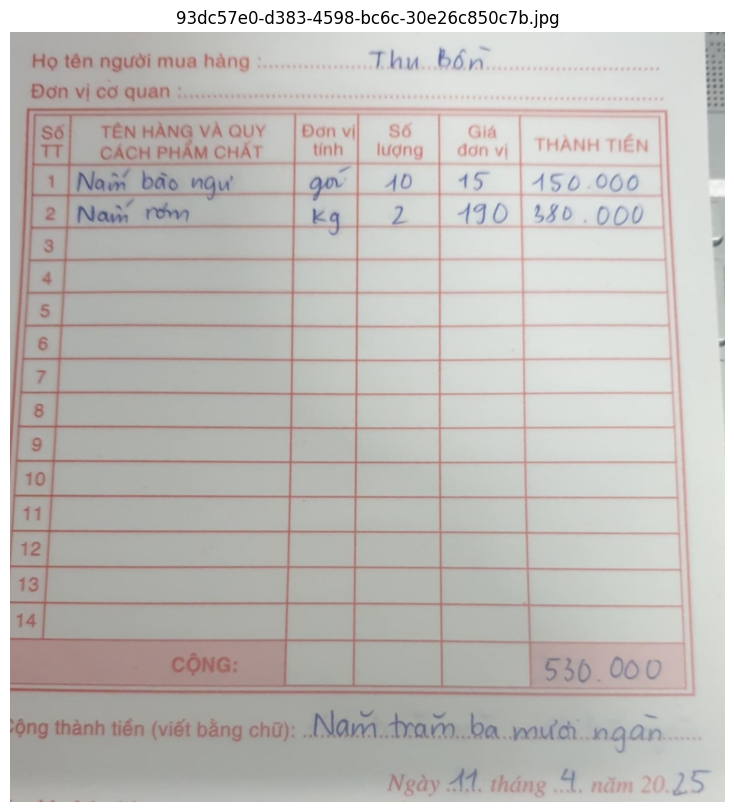

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 93dc57e0-d383-4598-bc6c-30e26c850c7b.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "11 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "15",
  "Thành tiền": "150.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "2",
  "Đơn giá": "190",
  "Thành tiền": "380.000"
}]

Đang xử lý: 92b3a4e4-5161-442b-9cc9-f0dd83c221f2.jpg


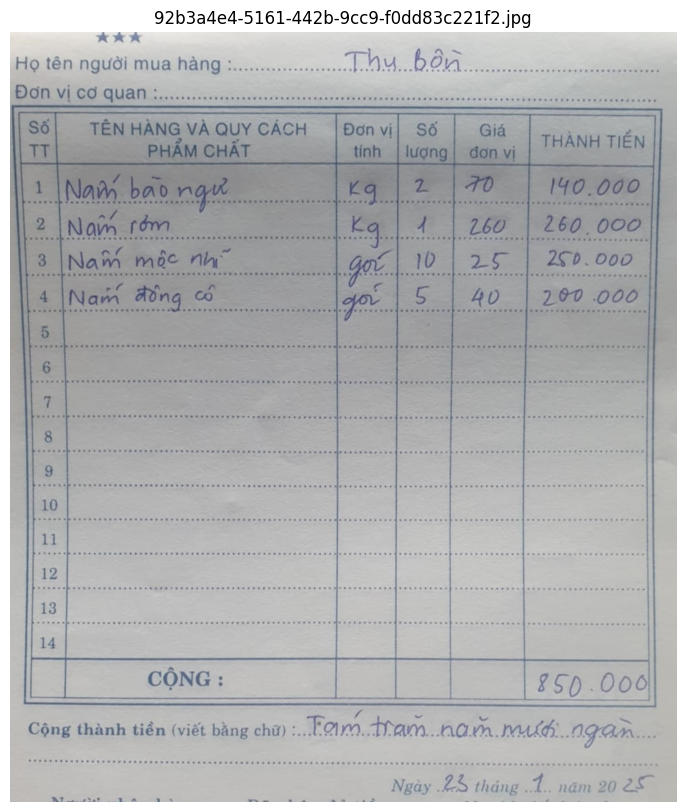

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 92b3a4e4-5161-442b-9cc9-f0dd83c221f2.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "23 tháng 1 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "kg",
  "Số lượng": 2,
  "Đơn giá": 70,
  "Thành tiền": 140000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 260,
  "Thành tiền": 260000
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ",
  "Đơn vị tính": "gói",
  "Số lượng": 10,
  "Đơn giá": 25,
  "Thành tiền": 250000
}, {
  "Tên mặt hàng": "Nấm đông cô",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 40,
  "Thành

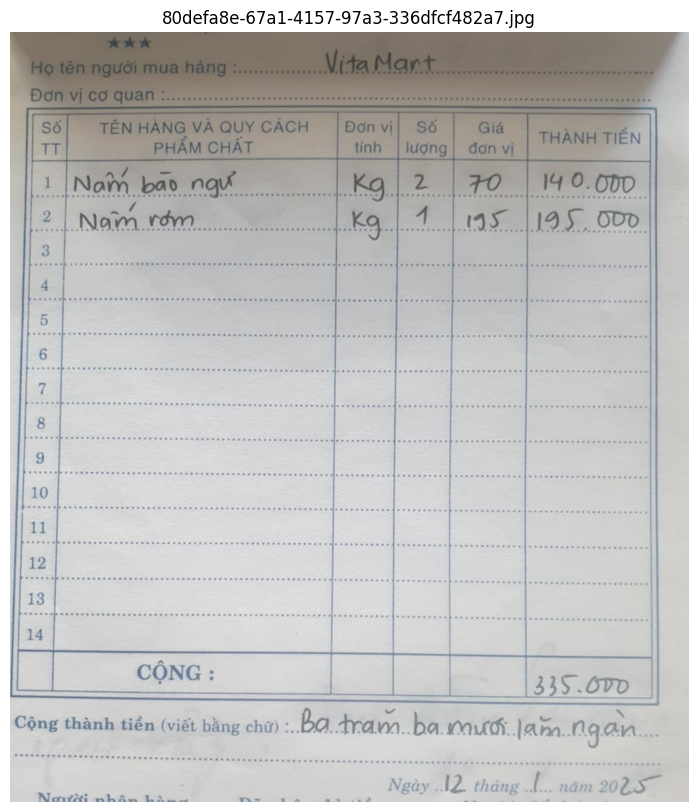

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 80defa8e-67a1-4157-97a3-336dfcf482a7.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "12 tháng 1 năm 2025",
  "Tên khách hàng": "VitaMart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Kg",
  "Số lượng": "2",
  "Đơn giá": "70",
  "Thành tiền": "140.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "195",
  "Thành tiền": "195.000"
}]

Đang xử lý: 65babd24-3241-454f-a55c-430bb98daf94.jpg


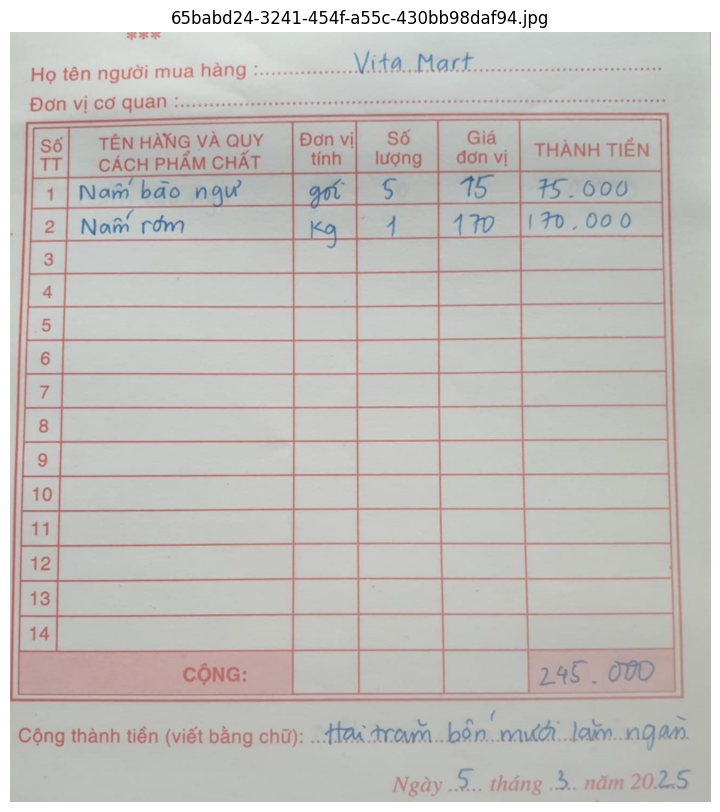

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 65babd24-3241-454f-a55c-430bb98daf94.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "5 tháng 3 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "75.000",
  "Thành tiền": "375.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "170.000",
  "Thành tiền": "170.000"
}]

Đang xử lý: 42f2065d-8932-4090-8ab9-0cdbdd5424dd.jpg


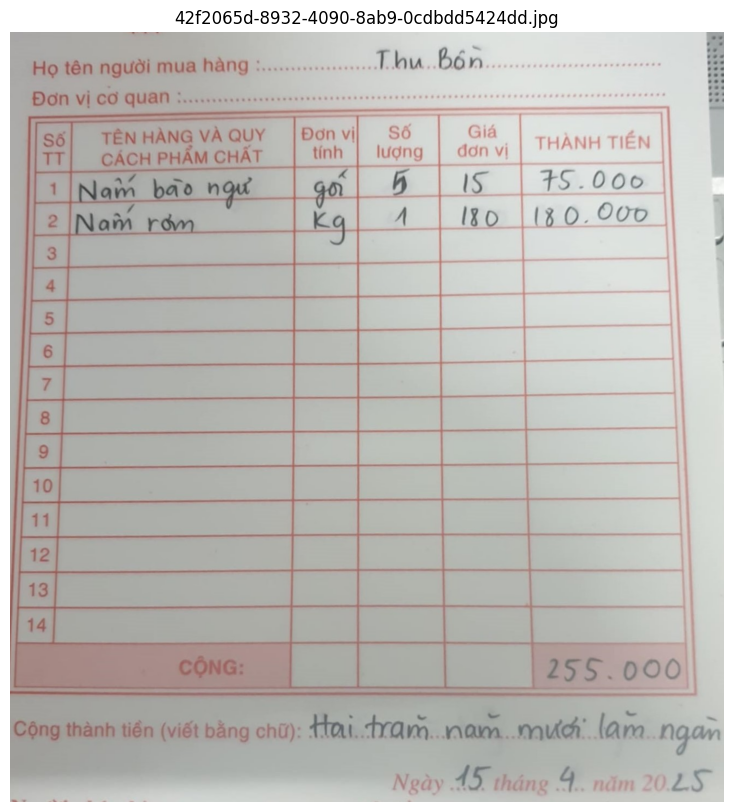

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 42f2065d-8932-4090-8ab9-0cdbdd5424dd.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "15 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 15,
  "Thành tiền": 75000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}]

Đang xử lý: 33cda353-4576-4f3f-91fb-b2d6f3e4906e.jpg


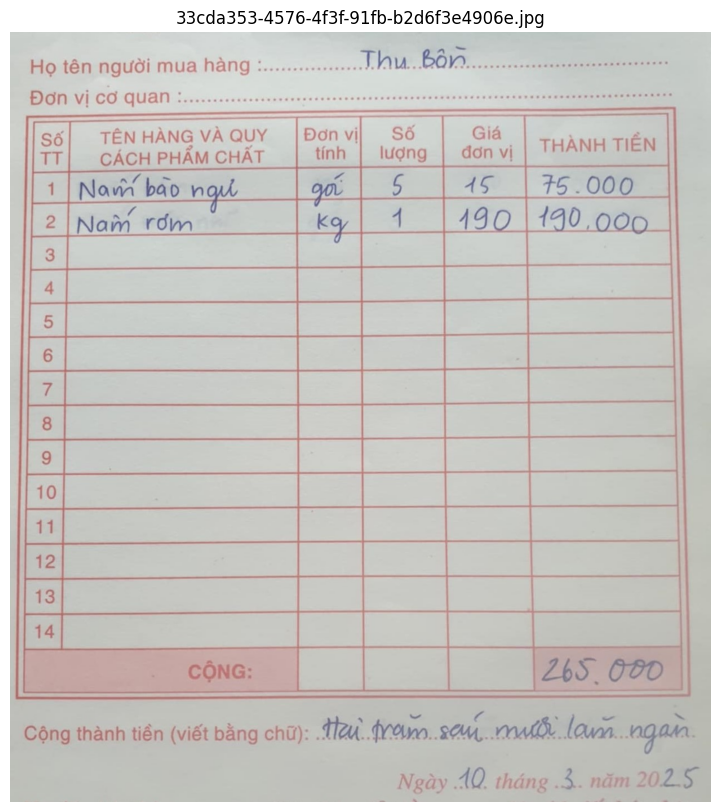

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 33cda353-4576-4f3f-91fb-b2d6f3e4906e.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "10 tháng 3 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "15",
  "Thành tiền": "75.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "190",
  "Thành tiền": "190.000"
}]

Đang xử lý: 16aff0f7-1a05-4e64-9263-27f7977e424c.jpg


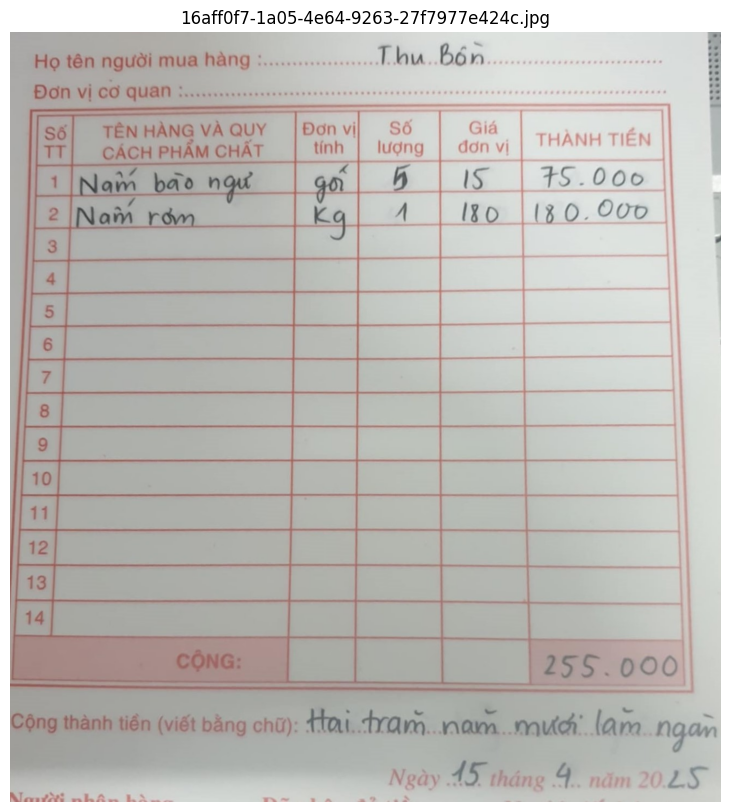

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 16aff0f7-1a05-4e64-9263-27f7977e424c.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "15 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 15,
  "Thành tiền": 75000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}]

Đang xử lý: 10beba04-108d-432e-b2af-f4d77527cc99.jpg


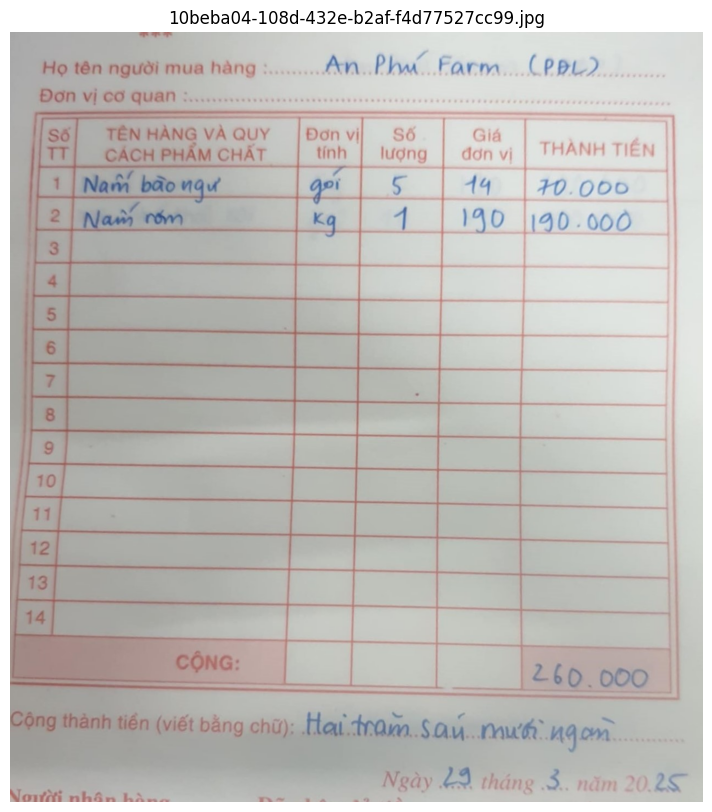

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 10beba04-108d-432e-b2af-f4d77527cc99.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "29 tháng 3 năm 2025",
  "Tên khách hàng": "An Phú Farm (PDL)"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "14",
  "Thành tiền": "70.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "190",
  "Thành tiền": "190.000"
}]

Đang xử lý: 9d2f0963-56c3-4299-b424-a5aa28f9950d.jpg


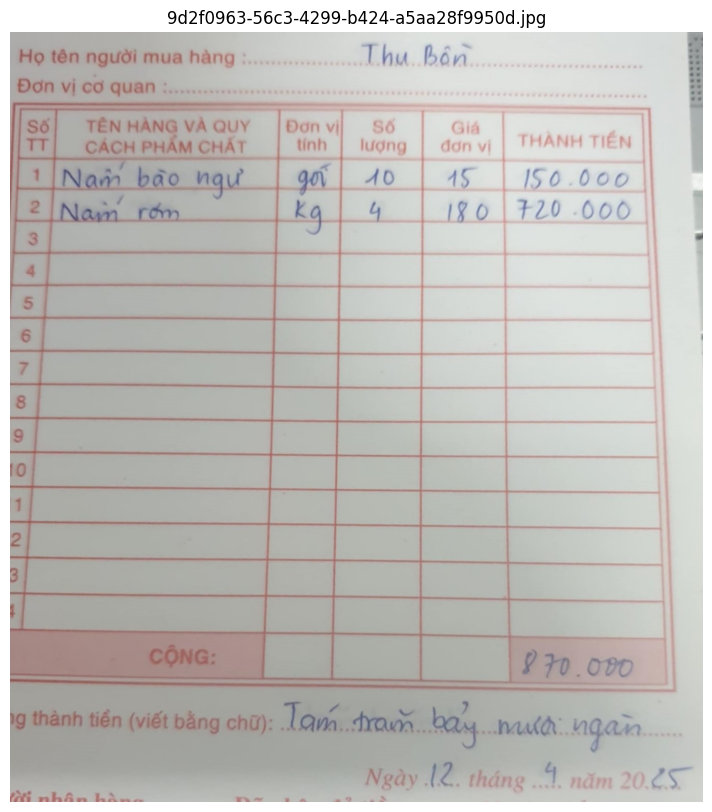

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 9d2f0963-56c3-4299-b424-a5aa28f9950d.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "12 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "15",
  "Thành tiền": "150.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "4",
  "Đơn giá": "180",
  "Thành tiền": "720.000"
}]

Đang xử lý: 8f547954-412c-45b9-9f79-bbcc9f51cd4d.jpg


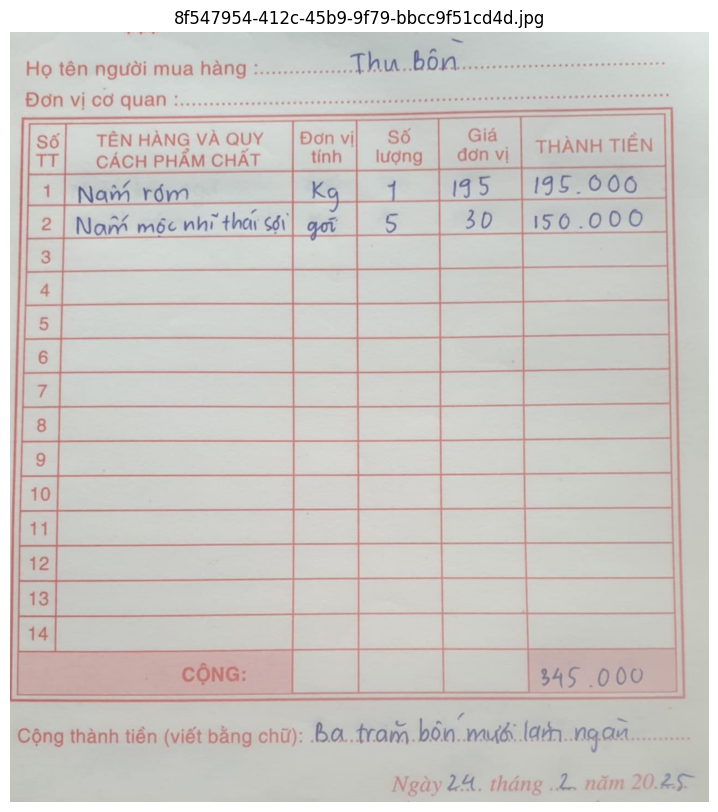

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 8f547954-412c-45b9-9f79-bbcc9f51cd4d.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "24 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 195,
  "Thành tiền": 195000
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ thái sợi",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 30,
  "Thành tiền": 150000
}]

Đang xử lý: 8d3d69e6-ba38-4089-948b-9cc0779eabb3.jpg


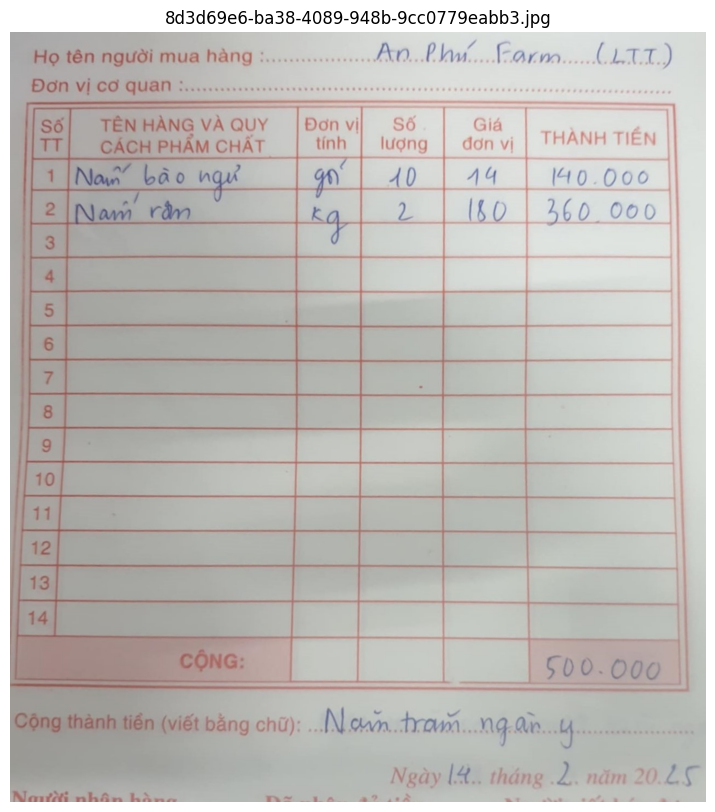

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 8d3d69e6-ba38-4089-948b-9cc0779eabb3.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "14 tháng 2 năm 2025",
  "Tên khách hàng": "An Phú Farm (LTT)"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Gói",
  "Số lượng": 10,
  "Đơn giá": 14,
  "Thành tiền": 140000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 2,
  "Đơn giá": 180,
  "Thành tiền": 360000
}]

Đang xử lý: 7ee5baaf-2b5d-4f7c-8973-5980a2ba40cb.jpg


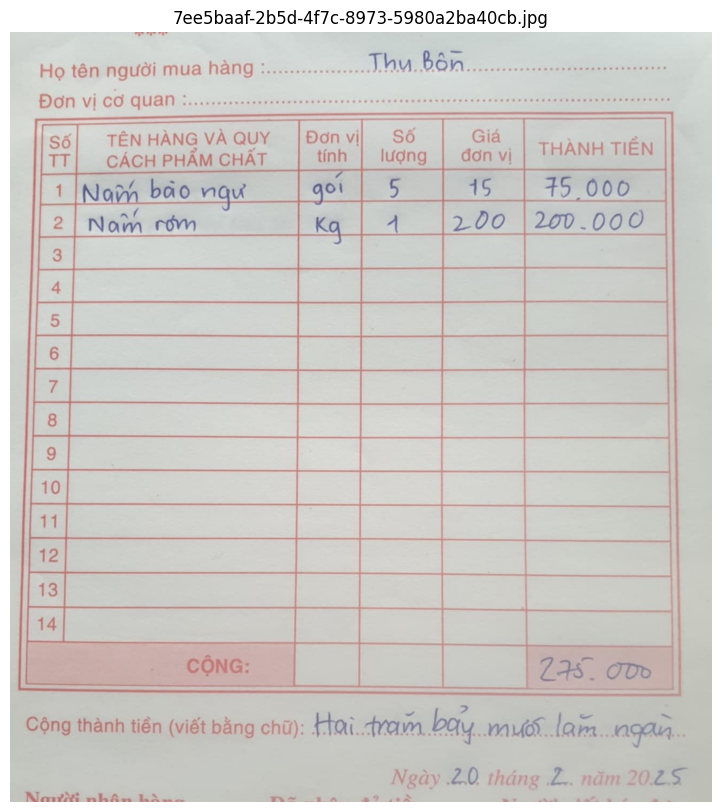

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 7ee5baaf-2b5d-4f7c-8973-5980a2ba40cb.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "20 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Gói",
  "Số lượng": 5,
  "Đơn giá": 15,
  "Thành tiền": 75000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 200,
  "Thành tiền": 200000
}]

Đang xử lý: 7a9b014e-99b0-4371-a87f-7b31c51b121c.jpg


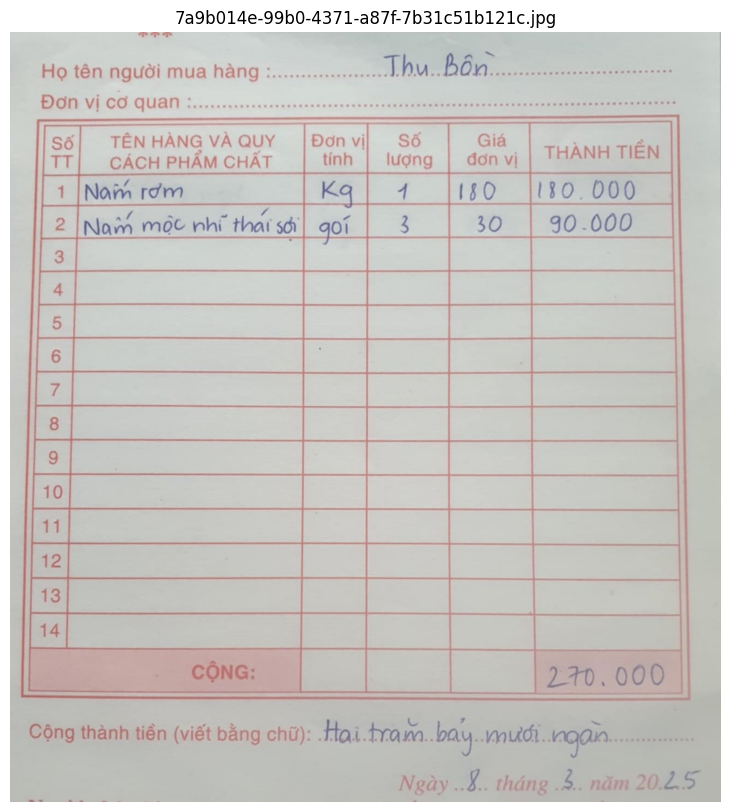

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 7a9b014e-99b0-4371-a87f-7b31c51b121c.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "8 tháng 3 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": 1,
  "Đơn giá": 180,
  "Thành tiền": 180000
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ thái sợi",
  "Đơn vị tính": "gói",
  "Số lượng": 3,
  "Đơn giá": 30,
  "Thành tiền": 90000
}]

Đang xử lý: 07fc956b-fa49-4605-a0a8-ddbd63515943.jpg


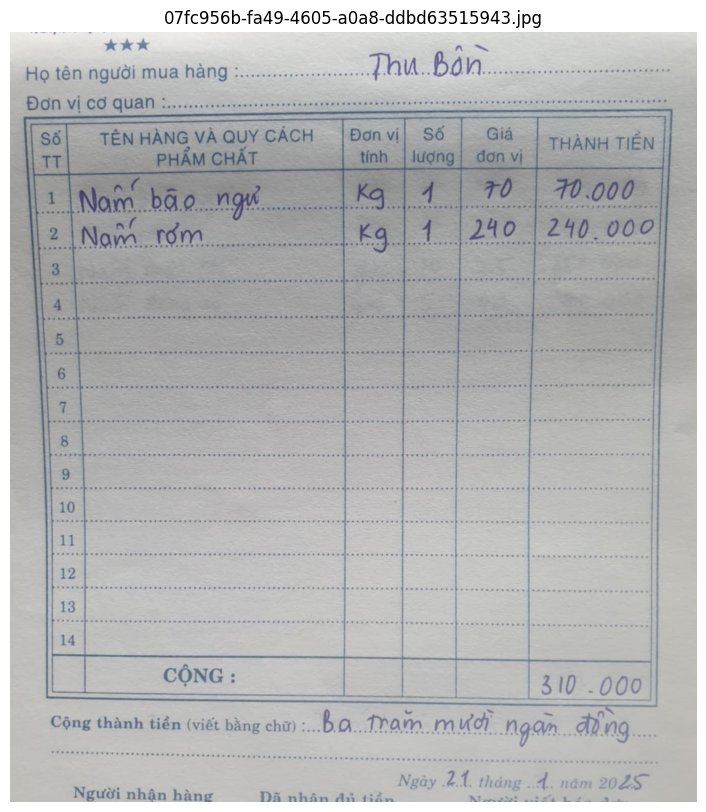

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 07fc956b-fa49-4605-a0a8-ddbd63515943.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "21 tháng 1 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "70.000",
  "Thành tiền": "70.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "240.000",
  "Thành tiền": "240.000"
}]

Đang xử lý: 6d043db2-176d-452a-b65f-106404f5ef50.jpg


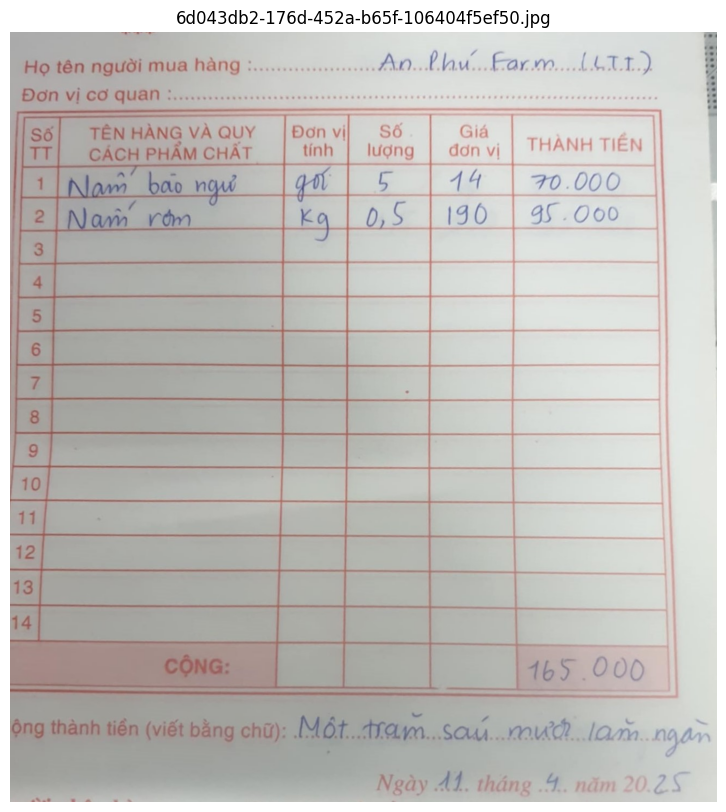

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 6d043db2-176d-452a-b65f-106404f5ef50.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "11 tháng 4 năm 2025",
  "Tên khách hàng": "An Phú Farm (LTT)"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "14",
  "Thành tiền": "70.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "0,5",
  "Đơn giá": "190",
  "Thành tiền": "95.000"
}]

Đang xử lý: 5f30811b-25ca-4343-a150-69a026c1b700.jpg


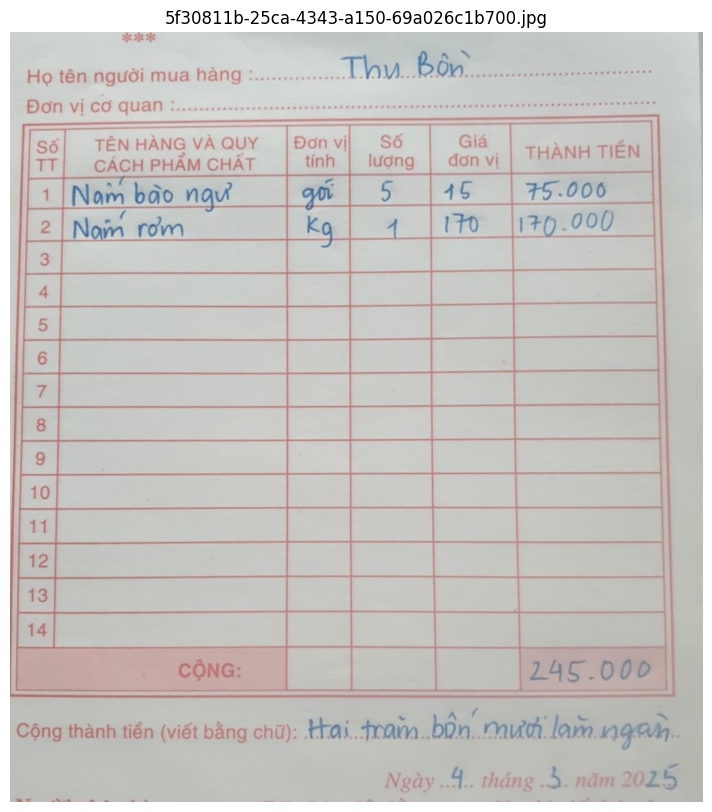

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 5f30811b-25ca-4343-a150-69a026c1b700.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "4 tháng 3 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 15,
  "Thành tiền": 75000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 170,
  "Thành tiền": 170000
}]

Đang xử lý: 5ee1e209-29b4-43b8-8e2e-1d60b778fcba.jpg


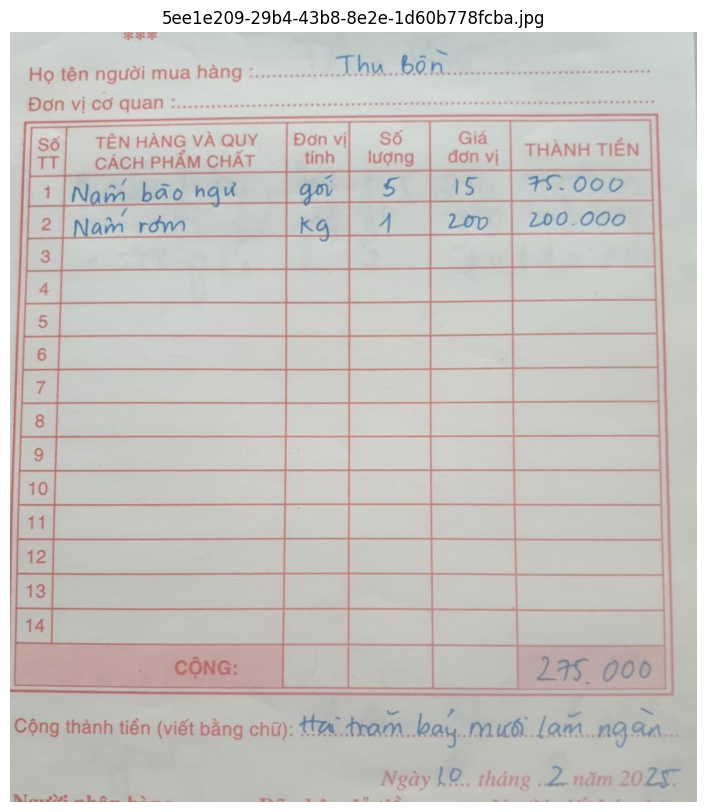

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 5ee1e209-29b4-43b8-8e2e-1d60b778fcba.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "10 tháng 2 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "15",
  "Thành tiền": "75.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "200",
  "Thành tiền": "200.000"
}]

Đang xử lý: 5df0740c-90d6-4df8-913f-a332606b0718.jpg


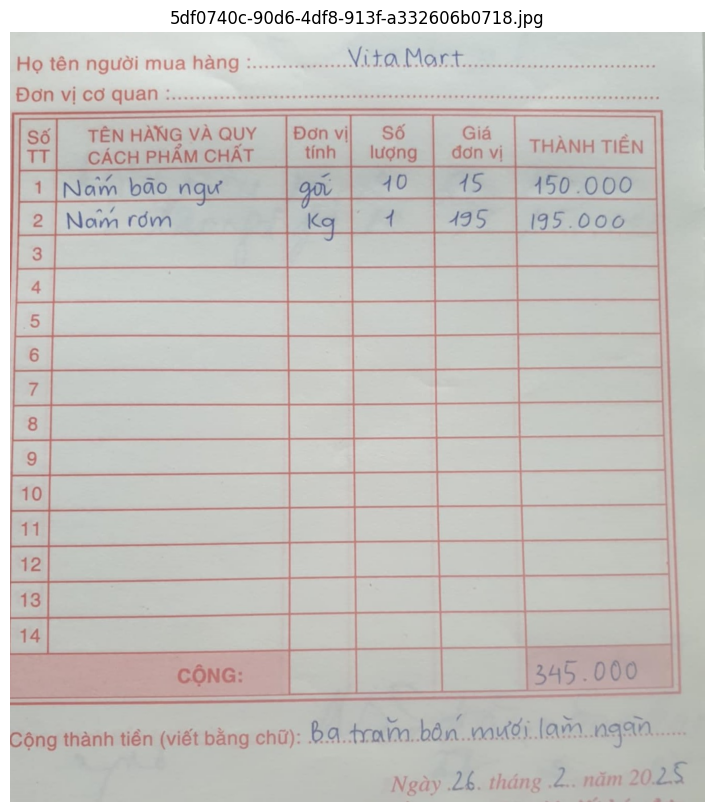

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 5df0740c-90d6-4df8-913f-a332606b0718.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "26 tháng 2 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": 10,
  "Đơn giá": 15,
  "Thành tiền": 150000
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 195,
  "Thành tiền": 195000
}]

Đang xử lý: 5.jpg


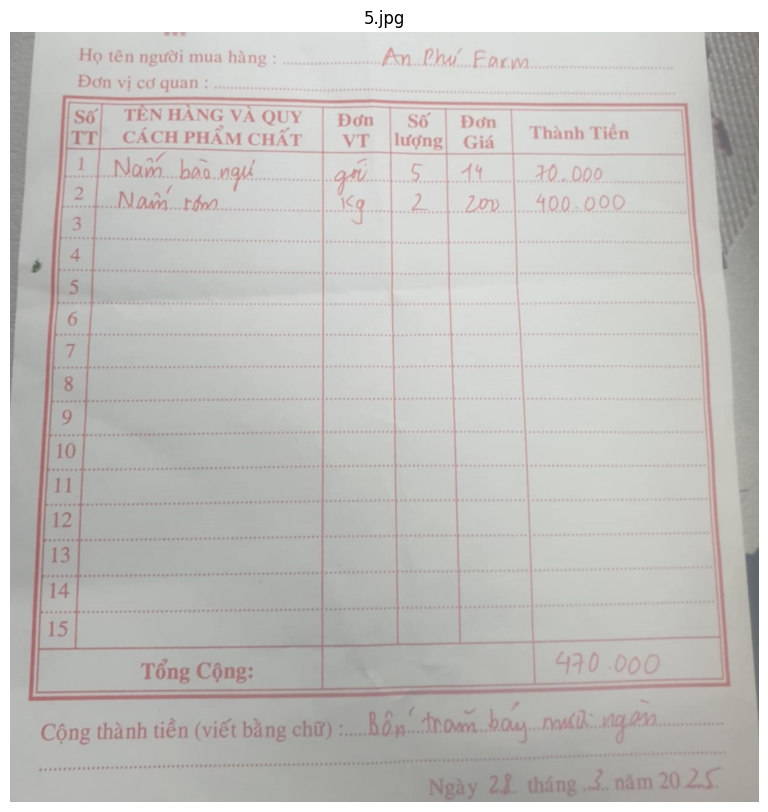

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 5.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "28 tháng 3 năm 2025",
  "Tên khách hàng": "An Phú Farm"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "14",
  "Thành tiền": "70.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "2",
  "Đơn giá": "200",
  "Thành tiền": "400.000"
}]

Đang xử lý: 3fbb0709-2969-4e7a-af0f-17277a4ff6d3.jpg


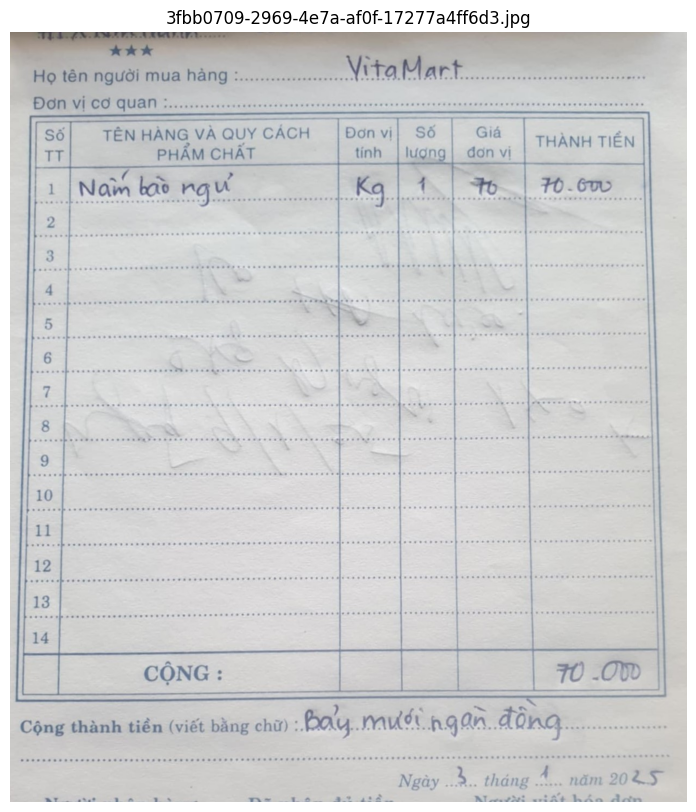

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 3fbb0709-2969-4e7a-af0f-17277a4ff6d3.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "3 tháng 1 năm 2025",
  "Tên khách hàng": "VitaMart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "Kg",
  "Số lượng": "1",
  "Đơn giá": "70",
  "Thành tiền": "70.000"
}]

Đang xử lý: 3f8bd2c8-f961-41e1-8c89-1dcb33be557e.jpg


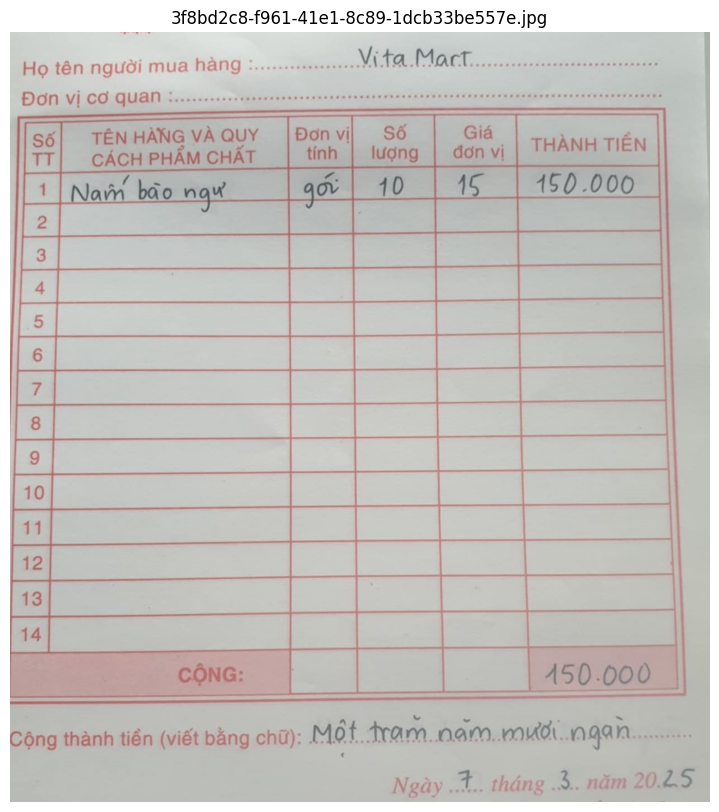

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 3f8bd2c8-f961-41e1-8c89-1dcb33be557e.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "7 tháng 3 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "10",
  "Đơn giá": "15",
  "Thành tiền": "150.000"
}]

Đang xử lý: 3.jpg


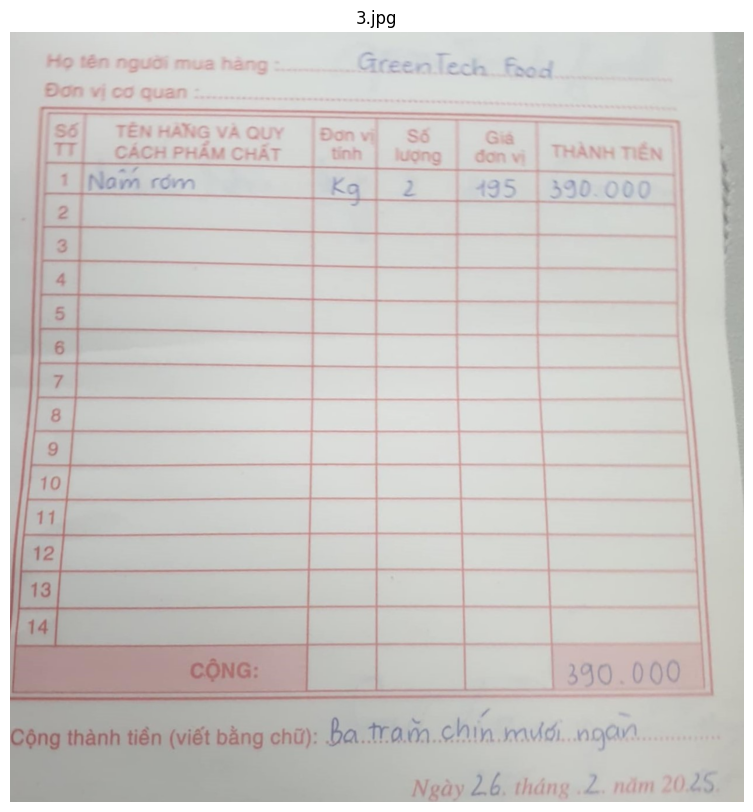

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 3.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "26 tháng 2 năm 2025",
  "Tên khách hàng": "GreenTech Food"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "Kg",
  "Số lượng": "2",
  "Đơn giá": "195",
  "Thành tiền": "390.000"
}]

Đang xử lý: 2.jpg


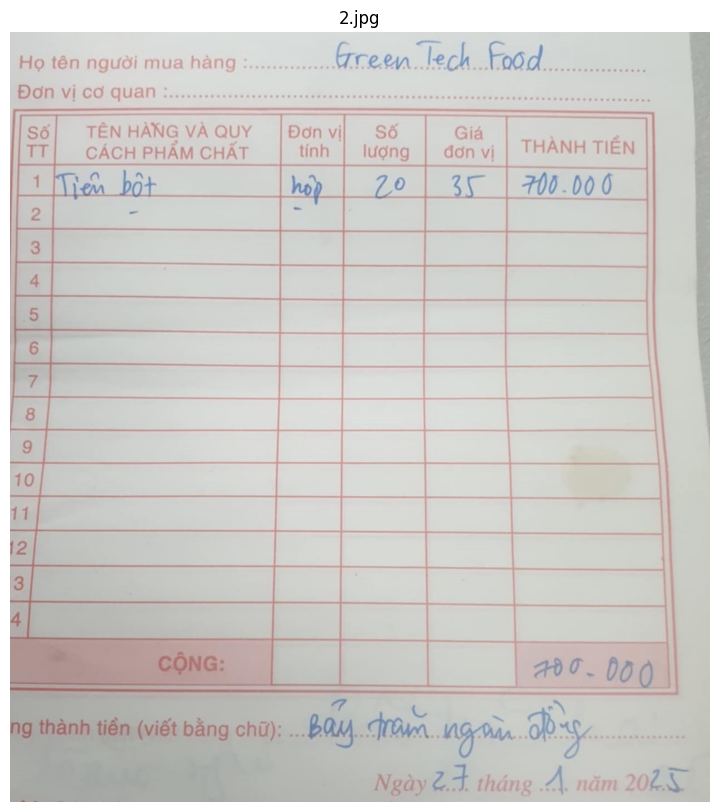

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 2.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "27 tháng 1 năm 2025",
  "Tên khách hàng": "Green Tech Food"
}, {
  "Tên mặt hàng": "Tiến bột",
  "Đơn vị tính": "Hộp",
  "Số lượng": "20",
  "Đơn giá": "35",
  "Thành tiền": "700.000"
}]

Đang xử lý: 1.jpg


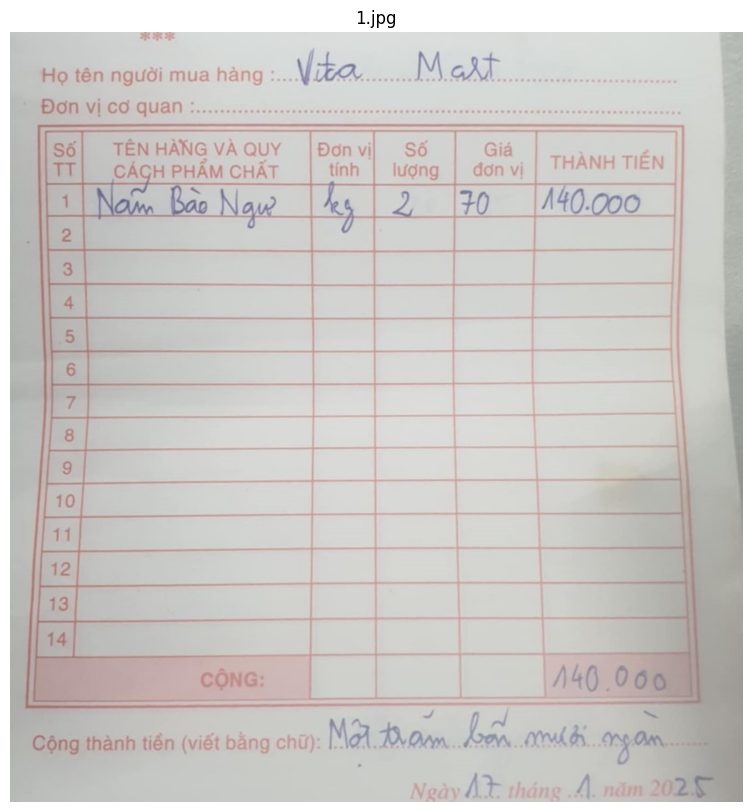

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 1.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "17 tháng 1 năm 2025",
  "Tên khách hàng": "Vita Mart"
}, {
  "Tên mặt hàng": "Nấm Bào Ngư",
  "Đơn vị tính": "kg",
  "Số lượng": "2",
  "Đơn giá": "70",
  "Thành tiền": "140.000"
}]

Đang xử lý: 0e066a5c-8097-414d-8911-5da8e44e414b.jpg


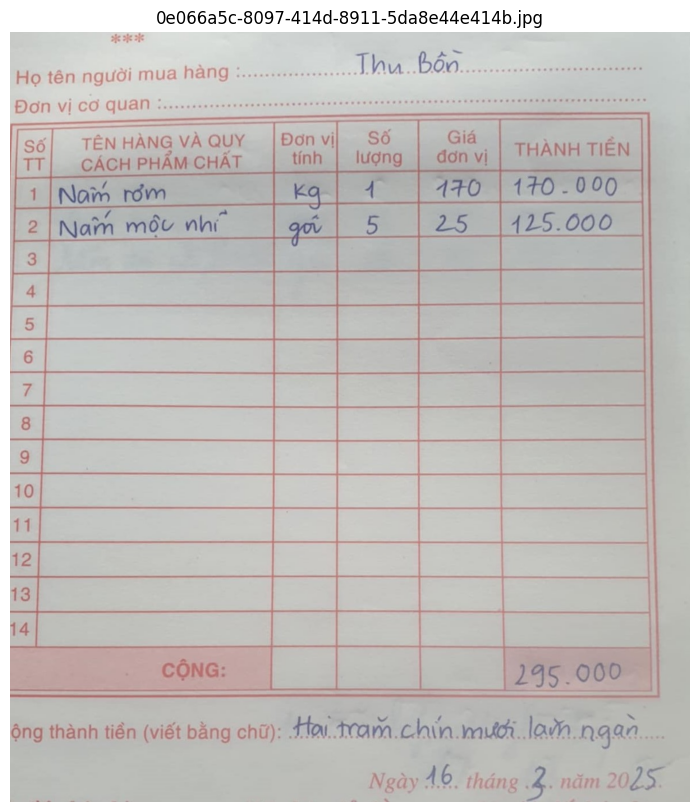

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 0e066a5c-8097-414d-8911-5da8e44e414b.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "16 tháng 3 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": 1,
  "Đơn giá": 170,
  "Thành tiền": 170000
}, {
  "Tên mặt hàng": "Nấm mộc nhĩ",
  "Đơn vị tính": "gói",
  "Số lượng": 5,
  "Đơn giá": 25,
  "Thành tiền": 125000
}]

Đang xử lý: 0b357f81-fb86-44f2-a7e0-9fab4039f67a.jpg


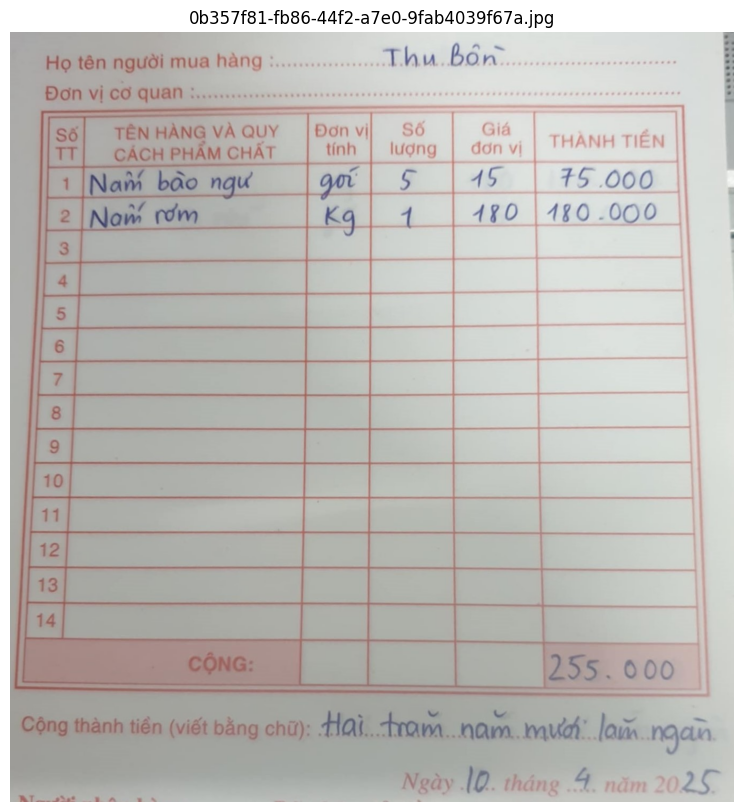

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: 0b357f81-fb86-44f2-a7e0-9fab4039f67a.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "10 tháng 4 năm 2025",
  "Tên khách hàng": "Thu Bồn"
}, {
  "Tên mặt hàng": "Nấm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "5",
  "Đơn giá": "15",
  "Thành tiền": "75.000"
}, {
  "Tên mặt hàng": "Nấm rơm",
  "Đơn vị tính": "kg",
  "Số lượng": "1",
  "Đơn giá": "180",
  "Thành tiền": "180.000"
}]

Đang xử lý: d98b7e49-2fe7-401c-85ad-f332ddaa06db.jpg


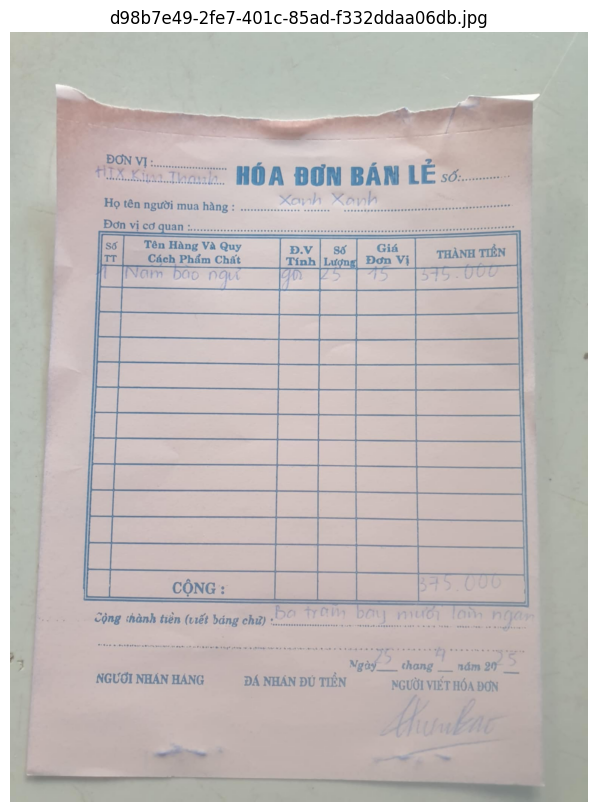

Setting `pad_token_id` to `eos_token_id`:151645 for open-end generation.


Image: d98b7e49-2fe7-401c-85ad-f332ddaa06db.jpg
User: <image>
Nhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]

Assistant: [{
  "Ngày tạo đơn": "25 tháng 4 năm 2025",
  "Tên khách hàng": "Xanh Xanh"
}, {
  "Tên mặt hàng": "Năm bào ngư",
  "Đơn vị tính": "gói",
  "Số lượng": "25",
  "Đơn giá": "15",
  "Thành tiền": "375.000"
}]

Đã hoàn thành và lưu kết quả vào text.txt


In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import torch
from google.colab import drive
from googleapiclient.discovery import build
from google.colab import auth
import io
from googleapiclient.http import MediaIoBaseDownload

# Mount Google Drive
drive.mount('/content/drive')

# Xác thực với Google
auth.authenticate_user()

# Khởi tạo Drive API
drive_service = build('drive', 'v3')

# ID thư mục chứa ảnh
folder_id = '12RlDiAswFlve6keAuOCcY979KNuG-Oou'

# Giả sử load_image, model, tokenizer đã được định nghĩa

# Hàm tải file từ Google Drive
def download_file_from_gdrive(file_id):
    request = drive_service.files().get_media(fileId=file_id)
    file_content = io.BytesIO()
    downloader = MediaIoBaseDownload(file_content, request)
    done = False
    while done is False:
        status, done = downloader.next_chunk()
    file_content.seek(0)
    return file_content

# Lấy danh sách các file ảnh từ thư mục
query = f"'{folder_id}' in parents and (mimeType contains 'image/')"
results = drive_service.files().list(
    q=query,
    fields="files(id, name, mimeType)"
).execute()

image_files = results.get('files', [])

# Cấu hình sinh văn bản
generation_config = dict(
    max_new_tokens=4096,
    do_sample=False,
    num_beams=3,
    repetition_penalty=3.5
)

# Câu hỏi cho mô hình
question = '''<image>\nNhận diện hoá đơn trong ảnh. Chỉ trả về phần liệt kê từng mặt hàng hàng dưới dạng JSON, phần Ngày tạo đơn và Tên khách hàng chỉ in ra một lần:
[
  {
    "Ngày tạo đơn": "Ngày tạo đơn",
    "Tên khách hàng": "Tên khách hàng",
  }
  {
    "Tên mặt hàng": "Tên mặt hàng",
    "Đơn vị tính": "Đơn vị tính",
    "Số lượng": "Số lượng",
    "Đơn giá": "Đơn giá",
    "Thành tiền": "Thành tiền"
  },
]
'''
# Tạo thư mục tạm để lưu ảnh
temp_image_folder = '/content/temp_images'
os.makedirs(temp_image_folder, exist_ok=True)

# Xử lý từng ảnh
with open("text.txt", "w", encoding="utf-8") as f:
    for image_file in image_files:
        file_id = image_file['id']
        file_name = image_file['name']

        print(f"Đang xử lý: {file_name}")

        # Tải file từ Google Drive
        file_content = download_file_from_gdrive(file_id)

        # Lưu tạm thời để xử lý
        temp_image_path = os.path.join(temp_image_folder, file_name)
        with open(temp_image_path, 'wb') as img_file:
            img_file.write(file_content.getbuffer())

        # Hiển thị ảnh
        plt.figure(figsize=(10, 10))
        plt.imshow(Image.open(temp_image_path))
        plt.title(file_name)
        plt.axis('off')
        plt.show()

        # Chuẩn bị dữ liệu ảnh
        pixel_values = load_image(temp_image_path, max_num=6).to(torch.bfloat16).cuda()

        # Gọi mô hình
        response = model.chat(tokenizer, pixel_values, question, generation_config)

        # In ra và ghi vào file
        print(f'Image: {file_name}\nUser: {question}\nAssistant: {response}\n')
        f.write(f'Image: {file_name}\nUser: {question}\nAssistant: {response}\n\n')

print("Đã hoàn thành và lưu kết quả vào text.txt")



In [ ]:
import re

def clean_output_file(input_path, output_path):
    with open(input_path, "r", encoding="utf-8") as fin, open(output_path, "w", encoding="utf-8") as fout:
        content = fin.read()
        # Tìm tất cả các block Assistant: ... (JSON)
        matches = re.findall(r'Assistant:\s*((\[.*?\]|\{.*?\}))', content, re.DOTALL)
        for match in matches:
            json_str = match[0].strip()
            fout.write(json_str + "\n\n")  # mỗi block cách nhau 1 dòng trống

# Upload text.txt lên Drive
from googleapiclient.http import MediaFileUpload
upload_folder_id = '15UgD93yNMci-PoZgZzqVhLVBMhBj5AUg'
media = MediaFileUpload('text.txt', mimetype='text/plain')
file_metadata = {'name': 'text.txt', 'parents': [upload_folder_id]}
uploaded = drive_service.files().create(
    body=file_metadata,
    media_body=media,
    fields='id'
).execute()
print(f"→ Upload thành công text.txt (ID: {uploaded['id']})")


→ Upload thành công text.txt (ID: 1WU5hxMGGdAM3_Ylfsdj165cRClZIf0SY)
